In [2]:
import pandas as pd
import joblib
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Load the dataset
file_path = "data.xlsx"
xls = pd.ExcelFile(file_path)
df = pd.read_excel(xls, sheet_name='Form responses 1')

# Define selected features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist in the dataset
selected_features = [col for col in selected_features if col in df.columns]

# Extract required columns
df_selected = df[selected_features + [target_variable]].copy()

# Convert categorical Yes/No and Present/Absent to binary (1/0)
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df_selected[col] = df_selected[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Convert gender to binary (Male = 1, Female = 0)
df_selected['Gender'] = df_selected['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numerical columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
for col in num_cols:
    df_selected[col] = pd.to_numeric(df_selected[col], errors='coerce')

# Fill missing values: Numerical columns with median
for col in num_cols:
    df_selected[col].fillna(df_selected[col].median(), inplace=True)

# Split dataset into features and target
X = df_selected.drop(columns=[target_variable])
y = df_selected[target_variable]

# Scale numerical features
scaler = StandardScaler()
X[num_cols] = scaler.fit_transform(X[num_cols])

# Split into train-test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Initialize models
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42, n_estimators=100),
    "Logistic Regression": LogisticRegression(random_state=42, max_iter=1000)
}

# Train and evaluate models
trained_models = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    trained_models[name] = model
    print(f"{name} Accuracy: {accuracy:.4f}")

# Save models
for name, model in trained_models.items():
    joblib.dump(model, f"{name.replace(' ', '_')}.joblib")

# Save scaler
joblib.dump(scaler, "scaler.joblib")

print("Trained models and scaler saved successfully.")


C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_34332\2017802835.py:49: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_selected[col].fillna(df_selected[col].median(), inplace=True)


Decision Tree Accuracy: 0.6333
Random Forest Accuracy: 0.6667
Logistic Regression Accuracy: 0.5833
Trained models and scaler saved successfully.


In [3]:
import pandas as pd
import joblib
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Load the dataset
file_path = "data.xlsx"
xls = pd.ExcelFile(file_path)
df = pd.read_excel(xls, sheet_name='Form responses 1')

# Define selected features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist in the dataset
selected_features = [col for col in selected_features if col in df.columns]

# Extract required columns
df_selected = df[selected_features + [target_variable]].copy()

# Convert categorical Yes/No and Present/Absent to binary (1/0)
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df_selected[col] = df_selected[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Convert gender to binary (Male = 1, Female = 0)
df_selected['Gender'] = df_selected['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numerical columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
for col in num_cols:
    df_selected[col] = pd.to_numeric(df_selected[col], errors='coerce')

# Fill missing values: Numerical columns with median
for col in num_cols:
    df_selected[col].fillna(df_selected[col].median(), inplace=True)

# Split dataset into features and target
X = df_selected.drop(columns=[target_variable])
y = df_selected[target_variable]

# Scale numerical features
scaler = StandardScaler()
X[num_cols] = scaler.fit_transform(X[num_cols])

# Split into train-test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Initialize models
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42, n_estimators=100),
    "Logistic Regression": LogisticRegression(random_state=42, max_iter=1000),
    "XGBoost": XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss', n_estimators=50, max_depth=3),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "SVM": SVC(kernel='linear', probability=True, random_state=42)
}

# Train and evaluate models
trained_models = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    trained_models[name] = model
    print(f"{name} Accuracy: {accuracy:.4f}")

# Save models
for name, model in trained_models.items():
    joblib.dump(model, f"{name.replace(' ', '_')}.joblib")

# Save scaler
joblib.dump(scaler, "scaler.joblib")

print("Trained models and scaler saved successfully.")


C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_34332\4130373697.py:52: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_selected[col].fillna(df_selected[col].median(), inplace=True)


Decision Tree Accuracy: 0.6333
Random Forest Accuracy: 0.6667
Logistic Regression Accuracy: 0.5833


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [22:15:00] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Accuracy: 0.6000
K-Nearest Neighbors Accuracy: 0.6333
SVM Accuracy: 0.5833
Trained models and scaler saved successfully.


In [4]:
import optuna

In [1]:
import pandas as pd
import joblib
import numpy as np
import optuna
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Load the dataset
file_path = "data.xlsx"
xls = pd.ExcelFile(file_path)
df = pd.read_excel(xls, sheet_name='Form responses 1')

# Define selected features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist in the dataset
selected_features = [col for col in selected_features if col in df.columns]

# Extract required columns
df_selected = df[selected_features + [target_variable]].copy()

# Convert categorical Yes/No and Present/Absent to binary (1/0)
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df_selected[col] = df_selected[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Convert gender to binary (Male = 1, Female = 0)
df_selected['Gender'] = df_selected['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numerical columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
for col in num_cols:
    df_selected[col] = pd.to_numeric(df_selected[col], errors='coerce')

# Fill missing values: Numerical columns with median
for col in num_cols:
    df_selected[col].fillna(df_selected[col].median(), inplace=True)

# Split dataset into features and target
X = df_selected.drop(columns=[target_variable])
y = df_selected[target_variable]

# Scale numerical features
scaler = StandardScaler()
X[num_cols] = scaler.fit_transform(X[num_cols])

# Split into train-test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Save scaler
joblib.dump(scaler, "scaler.joblib")


# Function to optimize hyperparameters for each model using Optuna
def optimize_model(trial, model_type):
    if model_type == "Decision Tree":
        params = {
            "max_depth": trial.suggest_int("max_depth", 3, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5)
        }
        model = DecisionTreeClassifier(**params, random_state=42)

    elif model_type == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 50, 200),
            "max_depth": trial.suggest_int("max_depth", 3, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5)
        }
        model = RandomForestClassifier(**params, random_state=42,n_jobs=-1)

    elif model_type == "Logistic Regression":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "max_iter": trial.suggest_int("max_iter", 100, 1000)
        }
        model = LogisticRegression(**params, random_state=42,n_jobs=-1)

    elif model_type == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 50, 200),
            "max_depth": trial.suggest_int("max_depth", 3, 10),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42,n_jobs=-1)

    elif model_type == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf", "poly"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_type == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 3, 15),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"])
        }
        model = KNeighborsClassifier(**params,n_jobs=-1)

    # Cross-validation score
    score = cross_val_score(model, X_train, y_train, cv=3, scoring="accuracy").mean()
    return score


# List of models to optimize
models_to_optimize = ["Decision Tree", "Random Forest", "Logistic Regression", "XGBoost", "SVM", "KNN"]

best_params = {}

for model_name in models_to_optimize:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5000,n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train the models with optimized hyperparameters
trained_models = {}

for model_name, params in best_params.items():
    if model_name == "Decision Tree":
        model = DecisionTreeClassifier(**params, random_state=42)
    elif model_name == "Random Forest":
        model = RandomForestClassifier(**params, random_state=42)
    elif model_name == "Logistic Regression":
        model = LogisticRegression(**params, random_state=42)
    elif model_name == "XGBoost":
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42)
    elif model_name == "SVM":
        model = SVC(**params, probability=True, random_state=42)
    elif model_name == "KNN":
        model = KNeighborsClassifier(**params)

    # Train and evaluate
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    trained_models[model_name] = model
    print(f"{model_name} Accuracy: {accuracy:.4f}")

# Save the trained models
for name, model in trained_models.items():
    joblib.dump(model, f"{name.replace(' ', '_')}.joblib")

print("All models and scaler saved successfully in the current directory.")


C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_5380\255696383.py:53: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_selected[col].fillna(df_selected[col].median(), inplace=True)
[I 2025-02-12 22:35:16,822] A new study created in memory with name: no-name-72d85848-7329-4a3b-aa1b-5ae4c7291b71
[I 2025-02-12 22:35:16,981] Trial 0 finished with value: 0.5397679324894514 and parameters: {'max_depth': 7, 'min_samples_split': 3, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.5397679324894514.
[I 2025-02-12 22:35:16,997] Tria

KeyboardInterrupt: 

In [2]:
import pandas as pd
import joblib
import numpy as np
import optuna
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Load the dataset
file_path = "data.xlsx"
xls = pd.ExcelFile(file_path)
df = pd.read_excel(xls, sheet_name='Form responses 1')

# Define selected features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist in the dataset
selected_features = [col for col in selected_features if col in df.columns]

# Extract required columns
df_selected = df[selected_features + [target_variable]].copy()

# Convert categorical Yes/No and Present/Absent to binary (1/0)
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df_selected[col] = df_selected[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Convert gender to binary (Male = 1, Female = 0)
df_selected['Gender'] = df_selected['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numerical columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
for col in num_cols:
    df_selected[col] = pd.to_numeric(df_selected[col], errors='coerce')

# Fill missing values: Numerical columns with median
for col in num_cols:
    df_selected[col].fillna(df_selected[col].median(), inplace=True)

# Split dataset into features and target
X = df_selected.drop(columns=[target_variable])
y = df_selected[target_variable]

# Handle class imbalance using SMOTE
smote = SMOTE(random_state=42)
X, y = smote.fit_resample(X, y)

# Feature Selection using SelectKBest
selector = SelectKBest(score_func=f_classif, k=10)  # Keep top 10 features
X_selected = selector.fit_transform(X, y)

# Scale numerical features using MinMaxScaler
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X_selected)

# Split into train-test sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)

# Save scaler
joblib.dump(scaler, "scaler.joblib")

# Function to optimize hyperparameters using Optuna
def optimize_model(trial, model_type):
    if model_type == "Decision Tree":
        params = {
            "max_depth": trial.suggest_int("max_depth", 3, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5)
        }
        model = DecisionTreeClassifier(**params, random_state=42)

    elif model_type == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 50, 300),
            "max_depth": trial.suggest_int("max_depth", 3, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_type == "Logistic Regression":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "max_iter": trial.suggest_int("max_iter", 100, 1000)
        }
        model = LogisticRegression(**params, random_state=42)

    elif model_type == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 50, 300),
            "max_depth": trial.suggest_int("max_depth", 3, 10),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.3, 1.0)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42)

    elif model_type == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf", "poly"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_type == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 3, 20),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"])
        }
        model = KNeighborsClassifier(**params)

    # Cross-validation score
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy").mean()
    return score


# List of models to optimize
models_to_optimize = ["Decision Tree", "Random Forest", "Logistic Regression", "XGBoost", "SVM", "KNN"]

best_params = {}

for model_name in models_to_optimize:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=50)  # Increased trials to 50
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train and save the best models
trained_models = {}

for model_name, params in best_params.items():
    if model_name == "Decision Tree":
        model = DecisionTreeClassifier(**params, random_state=42)
    elif model_name == "Random Forest":
        model = RandomForestClassifier(**params, random_state=42)
    elif model_name == "XGBoost":
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42)

    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    trained_models[model_name] = model
    print(f"{model_name} Accuracy: {accuracy:.4f}")

# Save the trained models
for name, model in trained_models.items():
    joblib.dump(model, f"{name.replace(' ', '_')}.joblib")

print("All models and scaler saved successfully.")


C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_5380\284649913.py:55: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_selected[col].fillna(df_selected[col].median(), inplace=True)
[I 2025-02-12 22:43:19,419] A new study created in memory with name: no-name-768bc6dd-9e28-4fb2-b872-2f286525a013
[I 2025-02-12 22:43:19,431] Trial 0 finished with value: 0.5977443609022556 and parameters: {'max_depth': 9, 'min_samples_split': 2, 'min_samples_leaf': 1}. Best is trial 0 with value: 0.5977443609022556.
[I 2025-02-12 22:43:19,442] Tria

Best parameters for Decision Tree: {'max_depth': 19, 'min_samples_split': 3, 'min_samples_leaf': 1}


[I 2025-02-12 22:43:20,681] Trial 0 finished with value: 0.6368421052631579 and parameters: {'n_estimators': 84, 'max_depth': 10, 'min_samples_split': 8, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.6368421052631579.
[I 2025-02-12 22:43:21,058] Trial 1 finished with value: 0.6120927318295739 and parameters: {'n_estimators': 96, 'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.6368421052631579.
[I 2025-02-12 22:43:21,425] Trial 2 finished with value: 0.6262531328320801 and parameters: {'n_estimators': 95, 'max_depth': 18, 'min_samples_split': 6, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.6368421052631579.
[I 2025-02-12 22:43:21,927] Trial 3 finished with value: 0.6261904761904762 and parameters: {'n_estimators': 127, 'max_depth': 19, 'min_samples_split': 10, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.6368421052631579.
[I 2025-02-12 22:43:23,096] Trial 4 finished with value: 0.6440476190476191 and parameters: {'n

Best parameters for Random Forest: {'n_estimators': 50, 'max_depth': 14, 'min_samples_split': 2, 'min_samples_leaf': 1}


[I 2025-02-12 22:43:57,946] Trial 11 finished with value: 0.5870927318295739 and parameters: {'C': 6.445680249953307, 'max_iter': 764}. Best is trial 5 with value: 0.587092731829574.
[I 2025-02-12 22:43:57,968] Trial 12 finished with value: 0.5800125313283208 and parameters: {'C': 2.3341220448988245, 'max_iter': 1000}. Best is trial 5 with value: 0.587092731829574.
[I 2025-02-12 22:43:57,989] Trial 13 finished with value: 0.5870927318295739 and parameters: {'C': 9.306568677499179, 'max_iter': 325}. Best is trial 5 with value: 0.587092731829574.
[I 2025-02-12 22:43:58,012] Trial 14 finished with value: 0.5799498746867168 and parameters: {'C': 5.786590770211741, 'max_iter': 697}. Best is trial 5 with value: 0.587092731829574.
[I 2025-02-12 22:43:58,034] Trial 15 finished with value: 0.5764411027568922 and parameters: {'C': 3.060144972860146, 'max_iter': 858}. Best is trial 5 with value: 0.587092731829574.
[I 2025-02-12 22:43:58,055] Trial 16 finished with value: 0.5870927318295739 and pa

Best parameters for Logistic Regression: {'C': 1.4757656288027174, 'max_iter': 737}


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [22:43:59] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [22:43:59] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
[I 2025-02-12 22:43:59,060] Trial 1 finished with value: 0.5977443609022557 and parameters: {'n_estimators': 146, 'max_depth': 3, 'learning_rate': 0.1371296632583256, 'colsample_bytree': 0.8287104997033017}. Best is trial 0 with value: 0.6048245614035088.
d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [22:43:59] WAR

Best parameters for XGBoost: {'n_estimators': 199, 'max_depth': 5, 'learning_rate': 0.28208448474297754, 'colsample_bytree': 0.994472901358113}


[I 2025-02-12 22:44:12,988] Trial 2 finished with value: 0.594110275689223 and parameters: {'C': 6.142147520245836, 'kernel': 'poly'}. Best is trial 0 with value: 0.5976817042606516.
[I 2025-02-12 22:44:13,040] Trial 3 finished with value: 0.6157268170426065 and parameters: {'C': 2.306544028740691, 'kernel': 'rbf'}. Best is trial 3 with value: 0.6157268170426065.
[I 2025-02-12 22:44:13,093] Trial 4 finished with value: 0.6013784461152882 and parameters: {'C': 0.5481792498825181, 'kernel': 'rbf'}. Best is trial 3 with value: 0.6157268170426065.
[I 2025-02-12 22:44:13,157] Trial 5 finished with value: 0.5905388471177945 and parameters: {'C': 5.584737157240563, 'kernel': 'poly'}. Best is trial 3 with value: 0.6157268170426065.
[I 2025-02-12 22:44:13,217] Trial 6 finished with value: 0.5763157894736842 and parameters: {'C': 3.7229599483778077, 'kernel': 'poly'}. Best is trial 3 with value: 0.6157268170426065.
[I 2025-02-12 22:44:13,286] Trial 7 finished with value: 0.594110275689223 and pa

Best parameters for SVM: {'C': 2.1310240973512684, 'kernel': 'rbf'}


[I 2025-02-12 22:44:16,054] Trial 8 finished with value: 0.6225563909774436 and parameters: {'n_neighbors': 13, 'weights': 'distance'}. Best is trial 7 with value: 0.6227443609022556.
[I 2025-02-12 22:44:16,071] Trial 9 finished with value: 0.6226190476190476 and parameters: {'n_neighbors': 16, 'weights': 'distance'}. Best is trial 7 with value: 0.6227443609022556.
[I 2025-02-12 22:44:16,089] Trial 10 finished with value: 0.6333959899749374 and parameters: {'n_neighbors': 17, 'weights': 'distance'}. Best is trial 10 with value: 0.6333959899749374.
[I 2025-02-12 22:44:16,107] Trial 11 finished with value: 0.6333959899749374 and parameters: {'n_neighbors': 17, 'weights': 'distance'}. Best is trial 10 with value: 0.6333959899749374.
[I 2025-02-12 22:44:16,122] Trial 12 finished with value: 0.6333959899749374 and parameters: {'n_neighbors': 17, 'weights': 'distance'}. Best is trial 10 with value: 0.6333959899749374.
[I 2025-02-12 22:44:16,137] Trial 13 finished with value: 0.62261904761904

Best parameters for KNN: {'n_neighbors': 3, 'weights': 'distance'}
Decision Tree Accuracy: 0.7324
Random Forest Accuracy: 0.7042
Logistic Regression Accuracy: 0.7042
XGBoost Accuracy: 0.6901


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [22:44:17] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


SVM Accuracy: 0.6901
KNN Accuracy: 0.6901
All models and scaler saved successfully.


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [22:44:17] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


In [3]:
import pandas as pd
import joblib
import numpy as np
import optuna
import multiprocessing
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Load the dataset
file_path = "data.xlsx"
xls = pd.ExcelFile(file_path)
df = pd.read_excel(xls, sheet_name='Form responses 1')

# Define selected features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure all feature columns exist in the dataset
selected_features = [col for col in selected_features if col in df.columns]

# Extract required columns
df_selected = df[selected_features + [target_variable]].copy()

# Convert categorical Yes/No and Present/Absent to binary (1/0)
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df_selected[col] = df_selected[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Convert gender to binary (Male = 1, Female = 0)
df_selected['Gender'] = df_selected['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numerical columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
for col in num_cols:
    df_selected[col] = pd.to_numeric(df_selected[col], errors='coerce')

# Fill missing values: Numerical columns with median
for col in num_cols:
    df_selected[col].fillna(df_selected[col].median(), inplace=True)

# Split dataset into features and target
X = df_selected.drop(columns=[target_variable])
y = df_selected[target_variable]

# Handle class imbalance using SMOTE
smote = SMOTE(random_state=42)
X, y = smote.fit_resample(X, y)

# Scale numerical features using StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split into train-test sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)

# Save scaler
joblib.dump(scaler, "scaler.joblib")

# Function to optimize hyperparameters using Optuna
def optimize_model(trial, model_type):
    if model_type == "Decision Tree":
        params = {
            "max_depth": trial.suggest_int("max_depth", 3, 30),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
            "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"])
        }
        model = DecisionTreeClassifier(**params, random_state=42)

    elif model_type == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 30),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
            "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"])
        }
        model = RandomForestClassifier(**params, random_state=42, n_jobs=-1)

    elif model_type == "Logistic Regression":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "max_iter": trial.suggest_int("max_iter", 200, 1000)
        }
        model = LogisticRegression(**params, random_state=42, n_jobs=-1)

    elif model_type == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.3, 1.0),
            "subsample": trial.suggest_float("subsample", 0.5, 1.0)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42, n_jobs=-1)

    elif model_type == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf", "poly"]),
            "gamma": trial.suggest_categorical("gamma", ["scale", "auto"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_type == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 3, 30),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"]),
            "metric": trial.suggest_categorical("metric", ["euclidean", "manhattan", "minkowski"])
        }
        model = KNeighborsClassifier(**params, n_jobs=-1)

    # Cross-validation score
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score


# List of models to optimize
models_to_optimize = ["Decision Tree", "Random Forest", "Logistic Regression", "XGBoost", "SVM", "KNN"]

best_params = {}

# Use parallel processing for Optuna
for model_name in models_to_optimize:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=100, n_jobs=-1)  # Increased trials to 100
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train and save the best models
trained_models = {}

for model_name, params in best_params.items():
    if model_name == "Decision Tree":
        model = DecisionTreeClassifier(**params, random_state=42)
    elif model_name == "Random Forest":
        model = RandomForestClassifier(**params, random_state=42, n_jobs=-1)
    elif model_name == "XGBoost":
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42, n_jobs=-1)

    model.fit(X_train, y_train)
    trained_models[model_name] = model

# Save the trained models
for name, model in trained_models.items():
    joblib.dump(model, f"{name.replace(' ', '_')}.joblib")

print("All models and scaler saved successfully.")


C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_5380\1357696535.py:55: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_selected[col].fillna(df_selected[col].median(), inplace=True)
[I 2025-02-12 23:28:33,090] A new study created in memory with name: no-name-7f0f996f-8031-46d2-8e8b-93f04b8fc73b
[I 2025-02-12 23:28:35,852] Trial 4 finished with value: 0.5515037593984963 and parameters: {'max_depth': 23, 'min_samples_split': 9, 'min_samples_leaf': 2, 'criterion': 'entropy'}. Best is trial 4 with value: 0.5515037593984963.
[I 202

Best parameters for Decision Tree: {'max_depth': 4, 'min_samples_split': 5, 'min_samples_leaf': 7, 'criterion': 'gini'}


[I 2025-02-12 23:28:37,899] Trial 3 finished with value: 0.6194235588972431 and parameters: {'n_estimators': 101, 'max_depth': 25, 'min_samples_split': 6, 'min_samples_leaf': 8, 'criterion': 'entropy'}. Best is trial 3 with value: 0.6194235588972431.
[I 2025-02-12 23:28:38,190] Trial 5 finished with value: 0.6407894736842106 and parameters: {'n_estimators': 163, 'max_depth': 4, 'min_samples_split': 6, 'min_samples_leaf': 6, 'criterion': 'entropy'}. Best is trial 5 with value: 0.6407894736842106.
[I 2025-02-12 23:28:38,609] Trial 6 finished with value: 0.6194235588972431 and parameters: {'n_estimators': 259, 'max_depth': 3, 'min_samples_split': 18, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 5 with value: 0.6407894736842106.
[I 2025-02-12 23:28:38,623] Trial 0 finished with value: 0.6976817042606516 and parameters: {'n_estimators': 420, 'max_depth': 25, 'min_samples_split': 4, 'min_samples_leaf': 4, 'criterion': 'entropy'}. Best is trial 0 with value: 0.697681704260651

Best parameters for Random Forest: {'n_estimators': 428, 'max_depth': 30, 'min_samples_split': 4, 'min_samples_leaf': 2, 'criterion': 'entropy'}


[I 2025-02-12 23:29:04,317] Trial 11 finished with value: 0.5765037593984962 and parameters: {'C': 0.202216151284384, 'max_iter': 237}. Best is trial 5 with value: 0.5800751879699247.
[I 2025-02-12 23:29:04,334] Trial 2 finished with value: 0.5765037593984962 and parameters: {'C': 7.383634452861433, 'max_iter': 257}. Best is trial 5 with value: 0.5800751879699247.
[I 2025-02-12 23:29:04,344] Trial 8 finished with value: 0.5765037593984962 and parameters: {'C': 7.37546021679554, 'max_iter': 573}. Best is trial 5 with value: 0.5800751879699247.
[I 2025-02-12 23:29:04,351] Trial 9 finished with value: 0.5800751879699247 and parameters: {'C': 4.2211271096928185, 'max_iter': 484}. Best is trial 5 with value: 0.5800751879699247.
[I 2025-02-12 23:29:04,376] Trial 13 finished with value: 0.5800751879699247 and parameters: {'C': 4.134028144522092, 'max_iter': 392}. Best is trial 5 with value: 0.5800751879699247.
[I 2025-02-12 23:29:04,379] Trial 14 finished with value: 0.5800751879699247 and pa

Best parameters for Logistic Regression: {'C': 1.2347222013257393, 'max_iter': 810}


[I 2025-02-12 23:29:06,006] Trial 1 finished with value: 0.6479323308270677 and parameters: {'n_estimators': 345, 'max_depth': 5, 'learning_rate': 0.160267104993071, 'colsample_bytree': 0.7248960812953883, 'subsample': 0.7981254581900652}. Best is trial 1 with value: 0.6479323308270677.
[I 2025-02-12 23:29:06,059] Trial 3 finished with value: 0.6763784461152882 and parameters: {'n_estimators': 169, 'max_depth': 7, 'learning_rate': 0.23347262563368856, 'colsample_bytree': 0.3896116886115297, 'subsample': 0.9220253307727655}. Best is trial 3 with value: 0.6763784461152882.
[I 2025-02-12 23:29:06,068] Trial 6 finished with value: 0.6444235588972431 and parameters: {'n_estimators': 325, 'max_depth': 15, 'learning_rate': 0.26407364022269963, 'colsample_bytree': 0.6823661122484089, 'subsample': 0.6603427918604992}. Best is trial 3 with value: 0.6763784461152882.
[I 2025-02-12 23:29:06,111] Trial 5 finished with value: 0.6442355889724312 and parameters: {'n_estimators': 116, 'max_depth': 13, 

Best parameters for XGBoost: {'n_estimators': 147, 'max_depth': 11, 'learning_rate': 0.29283943370377635, 'colsample_bytree': 0.5592954935443609, 'subsample': 0.852871231645586}


[I 2025-02-12 23:29:09,168] Trial 7 finished with value: 0.5765664160401003 and parameters: {'C': 6.921064749182198, 'kernel': 'linear', 'gamma': 'scale'}. Best is trial 4 with value: 0.6725563909774437.
[I 2025-02-12 23:29:09,168] Trial 5 finished with value: 0.6404761904761905 and parameters: {'C': 2.147302177988088, 'kernel': 'poly', 'gamma': 'auto'}. Best is trial 4 with value: 0.6725563909774437.
[I 2025-02-12 23:29:09,171] Trial 13 finished with value: 0.5765664160401003 and parameters: {'C': 3.5403319463835876, 'kernel': 'linear', 'gamma': 'scale'}. Best is trial 4 with value: 0.6725563909774437.
[I 2025-02-12 23:29:09,207] Trial 11 finished with value: 0.6510025062656641 and parameters: {'C': 3.6891741915359213, 'kernel': 'poly', 'gamma': 'auto'}. Best is trial 4 with value: 0.6725563909774437.
[I 2025-02-12 23:29:09,231] Trial 8 finished with value: 0.5765664160401003 and parameters: {'C': 7.041753910730618, 'kernel': 'linear', 'gamma': 'scale'}. Best is trial 4 with value: 0.

Best parameters for SVM: {'C': 0.8213037327544691, 'kernel': 'poly', 'gamma': 'scale'}


[I 2025-02-12 23:29:10,591] Trial 11 finished with value: 0.669172932330827 and parameters: {'n_neighbors': 27, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 6 with value: 0.6833333333333333.
[I 2025-02-12 23:29:10,595] Trial 5 finished with value: 0.5838345864661655 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 6 with value: 0.6833333333333333.
[I 2025-02-12 23:29:10,600] Trial 7 finished with value: 0.6335213032581454 and parameters: {'n_neighbors': 20, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 6 with value: 0.6833333333333333.
[I 2025-02-12 23:29:10,608] Trial 9 finished with value: 0.5943609022556391 and parameters: {'n_neighbors': 24, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 6 with value: 0.6833333333333333.
[I 2025-02-12 23:29:10,636] Trial 13 finished with value: 0.6832706766917294 and parameters: {'n_neighbors': 28, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 6

Best parameters for KNN: {'n_neighbors': 30, 'weights': 'distance', 'metric': 'euclidean'}


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [23:29:12] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


All models and scaler saved successfully.


In [2]:
import pandas as pd
import joblib
import numpy as np
import optuna
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Load the dataset
file_path = "data.xlsx"
xls = pd.ExcelFile(file_path)
df = pd.read_excel(xls, sheet_name='Form responses 1')

# Define selected features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure all feature columns exist in the dataset
selected_features = [col for col in selected_features if col in df.columns]

# Extract required columns
df_selected = df[selected_features + [target_variable]].copy()

# Convert categorical Yes/No and Present/Absent to binary (1/0)
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df_selected[col] = df_selected[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Convert gender to binary (Male = 1, Female = 0)
df_selected['Gender'] = df_selected['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numerical columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
for col in num_cols:
    df_selected[col] = pd.to_numeric(df_selected[col], errors='coerce')

# Fill missing values: Numerical columns with median
for col in num_cols:
    df_selected[col].fillna(df_selected[col].median(), inplace=True)

# Split dataset into features and target
X = df_selected.drop(columns=[target_variable])
y = df_selected[target_variable]

# Handle class imbalance using SMOTE
smote = SMOTE(random_state=42)
X, y = smote.fit_resample(X, y)

# Scale numerical features using StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split into train-test sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)

# Save scaler
joblib.dump(scaler, "scaler.joblib")

# Function to optimize hyperparameters using Optuna
def optimize_model(trial, model_type):
    if model_type == "Decision Tree":
        params = {
            "max_depth": trial.suggest_int("max_depth", 3, 30),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
            "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"])
        }
        model = DecisionTreeClassifier(**params, random_state=42)

    elif model_type == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 30),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
            "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"])
        }
        model = RandomForestClassifier(**params, random_state=42, n_jobs=-1)

    elif model_type == "Logistic Regression":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "max_iter": trial.suggest_int("max_iter", 200, 1000)
        }
        model = LogisticRegression(**params, random_state=42, n_jobs=-1)

    elif model_type == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.3, 1.0),
            "subsample": trial.suggest_float("subsample", 0.5, 1.0)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42, n_jobs=-1)

    elif model_type == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf", "poly"]),
            "gamma": trial.suggest_categorical("gamma", ["scale", "auto"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_type == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 3, 30),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"]),
            "metric": trial.suggest_categorical("metric", ["euclidean", "manhattan", "minkowski"])
        }
        model = KNeighborsClassifier(**params, n_jobs=-1)

    # Cross-validation score
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score


# List of models to optimize
models_to_optimize = ["Decision Tree", "Random Forest", "Logistic Regression", "XGBoost", "SVM", "KNN"]

best_params = {}

# Use parallel processing for Optuna
for model_name in models_to_optimize:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5000, n_jobs=-1)  # 100 trials
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train, evaluate, and save models
trained_models = {}
results = {}

for model_name, params in best_params.items():
    if model_name == "Decision Tree":
        model = DecisionTreeClassifier(**params, random_state=42)
    elif model_name == "Random Forest":
        model = RandomForestClassifier(**params, random_state=42, n_jobs=-1)
    elif model_name == "XGBoost":
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss', random_state=42, n_jobs=-1)

    model.fit(X_train, y_train)
    trained_models[model_name] = model

    # Evaluate the model
    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))

    results[model_name] = {"Train Accuracy": train_acc, "Test Accuracy": test_acc}
    print(f"{model_name} - Train Acc: {train_acc:.4f}, Test Acc: {test_acc:.4f}")

# Save models
for name, model in trained_models.items():
    joblib.dump(model, f"{name.replace(' ', '_')}.joblib")

print("\nFinal Results:", results)


C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_23440\4184675234.py:54: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_selected[col].fillna(df_selected[col].median(), inplace=True)
[I 2025-02-13 08:37:19,138] A new study created in memory with name: no-name-762810b6-454a-4b96-9a12-75a3d60459e7
[I 2025-02-13 08:37:19,230] Trial 0 finished with value: 0.4980576441102757 and parameters: {'max_depth': 11, 'min_samples_split': 18, 'min_samples_leaf': 1, 'criterion': 'entropy'}. Best is trial 0 with value: 0.4980576441102757.
[I 2

Best parameters for Decision Tree: {'max_depth': 11, 'min_samples_split': 7, 'min_samples_leaf': 3, 'criterion': 'gini'}


[I 2025-02-13 09:01:31,672] Trial 0 finished with value: 0.6442982456140351 and parameters: {'n_estimators': 170, 'max_depth': 29, 'min_samples_split': 15, 'min_samples_leaf': 7, 'criterion': 'entropy'}. Best is trial 0 with value: 0.6442982456140351.
[I 2025-02-13 09:01:32,770] Trial 1 finished with value: 0.6584586466165414 and parameters: {'n_estimators': 271, 'max_depth': 10, 'min_samples_split': 15, 'min_samples_leaf': 7, 'criterion': 'entropy'}. Best is trial 1 with value: 0.6584586466165414.
[I 2025-02-13 09:01:34,609] Trial 2 finished with value: 0.6869674185463659 and parameters: {'n_estimators': 421, 'max_depth': 27, 'min_samples_split': 10, 'min_samples_leaf': 2, 'criterion': 'gini'}. Best is trial 2 with value: 0.6869674185463659.
[I 2025-02-13 09:01:35,767] Trial 3 finished with value: 0.6549498746867168 and parameters: {'n_estimators': 203, 'max_depth': 30, 'min_samples_split': 17, 'min_samples_leaf': 9, 'criterion': 'gini'}. Best is trial 2 with value: 0.6869674185463659

Best parameters for Random Forest: {'n_estimators': 375, 'max_depth': 11, 'min_samples_split': 7, 'min_samples_leaf': 3, 'criterion': 'entropy'}


[I 2025-02-13 09:34:20,340] Trial 3 finished with value: 0.5800751879699247 and parameters: {'C': 0.15982159679375957, 'max_iter': 917}. Best is trial 4 with value: 0.5800751879699247.
[I 2025-02-13 09:34:20,340] Trial 5 finished with value: 0.5800751879699247 and parameters: {'C': 3.975326938385849, 'max_iter': 460}. Best is trial 4 with value: 0.5800751879699247.
[I 2025-02-13 09:34:20,344] Trial 10 finished with value: 0.5800751879699247 and parameters: {'C': 6.557734763193107, 'max_iter': 799}. Best is trial 4 with value: 0.5800751879699247.
[I 2025-02-13 09:34:20,370] Trial 9 finished with value: 0.5800751879699247 and parameters: {'C': 6.486281892557437, 'max_iter': 752}. Best is trial 4 with value: 0.5800751879699247.
[I 2025-02-13 09:34:20,398] Trial 7 finished with value: 0.5765037593984962 and parameters: {'C': 8.609199541634043, 'max_iter': 646}. Best is trial 4 with value: 0.5800751879699247.
[I 2025-02-13 09:34:20,426] Trial 6 finished with value: 0.5800751879699247 and pa

Best parameters for Logistic Regression: {'C': 0.013908196755635788, 'max_iter': 640}


[I 2025-02-13 09:39:28,083] Trial 0 finished with value: 0.6479323308270677 and parameters: {'n_estimators': 362, 'max_depth': 9, 'learning_rate': 0.15871759671981667, 'colsample_bytree': 0.7919554550111929, 'subsample': 0.9528247300609003}. Best is trial 0 with value: 0.6479323308270677.
[I 2025-02-13 09:39:28,161] Trial 8 finished with value: 0.6479949874686717 and parameters: {'n_estimators': 326, 'max_depth': 13, 'learning_rate': 0.23235805853455013, 'colsample_bytree': 0.48470122870927096, 'subsample': 0.8667117430413718}. Best is trial 8 with value: 0.6479949874686717.
[I 2025-02-13 09:39:28,237] Trial 7 finished with value: 0.6479323308270677 and parameters: {'n_estimators': 283, 'max_depth': 15, 'learning_rate': 0.21566586545628114, 'colsample_bytree': 0.48153654207848695, 'subsample': 0.7994270639145042}. Best is trial 8 with value: 0.6479949874686717.
[I 2025-02-13 09:39:28,249] Trial 2 finished with value: 0.6444235588972431 and parameters: {'n_estimators': 364, 'max_depth':

Best parameters for XGBoost: {'n_estimators': 484, 'max_depth': 5, 'learning_rate': 0.07184985212121445, 'colsample_bytree': 0.9462887041767953, 'subsample': 0.6400379019799253}


[I 2025-02-13 09:51:04,679] Trial 8 finished with value: 0.6652882205513786 and parameters: {'C': 3.2121062328016983, 'kernel': 'rbf', 'gamma': 'scale'}. Best is trial 8 with value: 0.6652882205513786.
[I 2025-02-13 09:51:04,684] Trial 12 finished with value: 0.643922305764411 and parameters: {'C': 9.224077496480154, 'kernel': 'poly', 'gamma': 'scale'}. Best is trial 8 with value: 0.6652882205513786.
[I 2025-02-13 09:51:04,694] Trial 15 finished with value: 0.6510651629072682 and parameters: {'C': 2.1861009049497757, 'kernel': 'rbf', 'gamma': 'auto'}. Best is trial 8 with value: 0.6652882205513786.
[I 2025-02-13 09:51:04,708] Trial 7 finished with value: 0.5765664160401003 and parameters: {'C': 2.825120991053591, 'kernel': 'linear', 'gamma': 'auto'}. Best is trial 8 with value: 0.6652882205513786.
[I 2025-02-13 09:51:04,712] Trial 1 finished with value: 0.5765664160401003 and parameters: {'C': 8.740408596735936, 'kernel': 'linear', 'gamma': 'auto'}. Best is trial 8 with value: 0.665288

Best parameters for SVM: {'C': 2.6692256767288294, 'kernel': 'rbf', 'gamma': 'scale'}


[I 2025-02-13 09:54:59,520] Trial 4 finished with value: 0.6051378446115289 and parameters: {'n_neighbors': 25, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.6833333333333333.
[I 2025-02-13 09:54:59,526] Trial 5 finished with value: 0.5943609022556391 and parameters: {'n_neighbors': 24, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 3 with value: 0.6833333333333333.
[I 2025-02-13 09:54:59,529] Trial 7 finished with value: 0.6299498746867168 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 3 with value: 0.6833333333333333.
[I 2025-02-13 09:54:59,529] Trial 11 finished with value: 0.6726817042606517 and parameters: {'n_neighbors': 21, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.6833333333333333.
[I 2025-02-13 09:54:59,560] Trial 9 finished with value: 0.6299498746867168 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 3 

Best parameters for KNN: {'n_neighbors': 30, 'weights': 'distance', 'metric': 'minkowski'}
Decision Tree - Train Acc: 0.8577, Test Acc: 0.7042
Random Forest - Train Acc: 0.8897, Test Acc: 0.6901
Logistic Regression - Train Acc: 0.8897, Test Acc: 0.6901
XGBoost - Train Acc: 0.9964, Test Acc: 0.7324


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [10:00:08] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [10:00:09] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


SVM - Train Acc: 0.9964, Test Acc: 0.7324
KNN - Train Acc: 0.9964, Test Acc: 0.7324


d:\Project_assests\miniconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [10:00:09] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)



Final Results: {'Decision Tree': {'Train Accuracy': 0.8576512455516014, 'Test Accuracy': 0.704225352112676}, 'Random Forest': {'Train Accuracy': 0.8896797153024911, 'Test Accuracy': 0.6901408450704225}, 'Logistic Regression': {'Train Accuracy': 0.8896797153024911, 'Test Accuracy': 0.6901408450704225}, 'XGBoost': {'Train Accuracy': 0.99644128113879, 'Test Accuracy': 0.7323943661971831}, 'SVM': {'Train Accuracy': 0.99644128113879, 'Test Accuracy': 0.7323943661971831}, 'KNN': {'Train Accuracy': 0.99644128113879, 'Test Accuracy': 0.7323943661971831}}


In [5]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
from imblearn.combine import SMOTEENN
from imblearn.over_sampling import ADASYN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN (removes noise)
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)

# Save scaler
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Model optimization function
def optimize_model(trial, model_type):
    if model_type == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_type == "CatBoost":
        params = {
            "iterations": trial.suggest_int("iterations", 100, 500),
            "depth": trial.suggest_int("depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1, 10),
        }
        model = cb.CatBoostClassifier(**params, verbose=0, random_state=42)

    elif model_type == "MLP":
        params = {
            "hidden_layer_sizes": trial.suggest_categorical("hidden_layer_sizes", [(64,), (128,), (128, 64)]),
            "alpha": trial.suggest_float("alpha", 0.0001, 0.01),
            "learning_rate_init": trial.suggest_float("learning_rate_init", 0.001, 0.01)
        }
        model = MLPClassifier(**params, max_iter=500, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Optimize models
models_to_optimize = ["LightGBM", "CatBoost", "MLP"]
best_params = {}

for model_name in models_to_optimize:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train and evaluate models
models = {
    "LightGBM": lgb.LGBMClassifier(**best_params["LightGBM"], random_state=42),
    "CatBoost": cb.CatBoostClassifier(**best_params["CatBoost"], verbose=0, random_state=42),
    "MLP": MLPClassifier(**best_params["MLP"], max_iter=500, random_state=42)
}

trained_models = {}
results = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    results[name] = {"Train Accuracy": train_acc, "Test Accuracy": test_acc}
    print(f"{name} - Train Acc: {train_acc:.4f}, Test Acc: {test_acc:.4f}")

# Stacking Classifier
stacking_clf = StackingClassifier(
    estimators=[("LGBM", models["LightGBM"]), ("CatBoost", models["CatBoost"])],
    final_estimator=LogisticRegression()
)
stacking_clf.fit(X_train, y_train)
joblib.dump(stacking_clf, "Stacking_Classifier.joblib")

# Voting Classifier
voting_clf = VotingClassifier(
    estimators=[("LGBM", models["LightGBM"]), ("CatBoost", models["CatBoost"]), ("MLP", models["MLP"])],
    voting="hard"
)
voting_clf.fit(X_train, y_train)
joblib.dump(voting_clf, "Voting_Classifier.joblib")

# Print final results
print("\nFinal Results:", results)

stack_train_acc = accuracy_score(y_train, stacking_clf.predict(X_train))
stack_test_acc = accuracy_score(y_test, stacking_clf.predict(X_test))
print(f"Stacking Classifier - Train Acc: {stack_train_acc:.4f}, Test Acc: {stack_test_acc:.4f}")

vote_train_acc = accuracy_score(y_train, voting_clf.predict(X_train))
vote_test_acc = accuracy_score(y_test, voting_clf.predict(X_test))
print(f"Voting Classifier - Train Acc: {vote_train_acc:.4f}, Test Acc: {vote_test_acc:.4f}")


[I 2025-02-13 10:13:02,536] A new study created in memory with name: no-name-62af0a6e-cf89-4f74-8249-5289d60b28b8
[I 2025-02-13 10:13:14,154] Trial 1 finished with value: 0.6133333333333333 and parameters: {'n_estimators': 435, 'learning_rate': 0.27832821734209784, 'max_depth': 14, 'num_leaves': 43}. Best is trial 1 with value: 0.6133333333333333.
[I 2025-02-13 10:13:14,240] Trial 2 finished with value: 0.6666666666666666 and parameters: {'n_estimators': 280, 'learning_rate': 0.20268830420486952, 'max_depth': 6, 'num_leaves': 65}. Best is trial 2 with value: 0.6666666666666666.
[I 2025-02-13 10:13:14,265] Trial 3 finished with value: 0.64 and parameters: {'n_estimators': 285, 'learning_rate': 0.1781753633803112, 'max_depth': 10, 'num_leaves': 112}. Best is trial 2 with value: 0.6666666666666666.
[I 2025-02-13 10:13:14,344] Trial 4 finished with value: 0.5866666666666667 and parameters: {'n_estimators': 436, 'learning_rate': 0.0185715127487516, 'max_depth': 5, 'num_leaves': 32}. Best is

Best parameters for LightGBM: {'n_estimators': 280, 'learning_rate': 0.20268830420486952, 'max_depth': 6, 'num_leaves': 65}


[W 2025-02-13 10:13:21,293] Trial 1 failed with parameters: {'iterations': 357, 'depth': 9, 'learning_rate': 0.03956929781779367, 'l2_leaf_reg': 1.2833847483959553} because of the following error: The value nan is not acceptable.
[W 2025-02-13 10:13:21,296] Trial 1 failed with value nan.
[I 2025-02-13 10:13:44,865] Trial 3 finished with value: 0.76 and parameters: {'iterations': 185, 'depth': 13, 'learning_rate': 0.23552943813739463, 'l2_leaf_reg': 7.282838540442895}. Best is trial 3 with value: 0.76.
[W 2025-02-13 10:13:51,888] Trial 2 failed with parameters: {'iterations': 163, 'depth': 15, 'learning_rate': 0.11003770149145489, 'l2_leaf_reg': 1.6240029011609995} because of the following error: The value nan is not acceptable.
[W 2025-02-13 10:13:51,890] Trial 2 failed with value nan.
[I 2025-02-13 10:13:53,263] Trial 4 finished with value: 0.8533333333333333 and parameters: {'iterations': 223, 'depth': 14, 'learning_rate': 0.207765343611993, 'l2_leaf_reg': 3.724563243097446}. Best is

Best parameters for CatBoost: {'iterations': 345, 'depth': 15, 'learning_rate': 0.06247168746122195, 'l2_leaf_reg': 2.5392756709418993}


[I 2025-02-13 10:13:57,560] Trial 0 finished with value: 0.7866666666666667 and parameters: {'hidden_layer_sizes': (64,), 'alpha': 0.0027946968053219473, 'learning_rate_init': 0.007969206407508832}. Best is trial 0 with value: 0.7866666666666667.
[I 2025-02-13 10:13:57,570] Trial 2 finished with value: 0.7866666666666667 and parameters: {'hidden_layer_sizes': (64,), 'alpha': 0.001035395604973448, 'learning_rate_init': 0.009655383143543389}. Best is trial 0 with value: 0.7866666666666667.
[I 2025-02-13 10:13:57,643] Trial 1 finished with value: 0.8133333333333332 and parameters: {'hidden_layer_sizes': (128,), 'alpha': 0.0027518067877684836, 'learning_rate_init': 0.009282980355002149}. Best is trial 1 with value: 0.8133333333333332.
[I 2025-02-13 10:13:57,644] Trial 3 finished with value: 0.8 and parameters: {'hidden_layer_sizes': (128, 64), 'alpha': 0.0029261389544056, 'learning_rate_init': 0.006126042481909832}. Best is trial 1 with value: 0.8133333333333332.
[I 2025-02-13 10:13:57,645

Best parameters for MLP: {'hidden_layer_sizes': (128,), 'alpha': 0.0027518067877684836, 'learning_rate_init': 0.009282980355002149}
[LightGBM] [Info] Number of positive: 26, number of negative: 49
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000027 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 68
[LightGBM] [Info] Number of data points in the train set: 75, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.346667 -> initscore=-0.633724
[LightGBM] [Info] Start training from score -0.633724
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

In [4]:
%pip install lightgbm catboost

  Using cached lightgbm-4.5.0-py3-none-win_amd64.whl.metadata (17 kB)
Using cached lightgbm-4.5.0-py3-none-win_amd64.whl (1.4 MB)
   ---------------------------------------- 0.0/101.7 MB ? eta -:--:--
   ---------------------------------------- 0.0/101.7 MB 960.0 kB/s eta 0:01:46
   ---------------------------------------- 0.3/101.7 MB 3.1 MB/s eta 0:00:33
   ---------------------------------------- 1.2/101.7 MB 9.3 MB/s eta 0:00:11
   - -------------------------------------- 2.8/101.7 MB 16.5 MB/s eta 0:00:06
   - -------------------------------------- 3.2/101.7 MB 15.8 MB/s eta 0:00:07
   -- ------------------------------------- 5.3/101.7 MB 19.8 MB/s eta 0:00:05
   -- ------------------------------------- 5.4/101.7 MB 19.2 MB/s eta 0:00:06
   --- ------------------------------------ 7.9/101.7 MB 21.9 MB/s eta 0:00:05
   --- ------------------------------------ 9.1/101.7 MB 22.4 MB/s eta 0:00:05
   ---- ----------------------------------- 10.4/101.7 MB 26.2 MB/s eta 0:00:04
   ---- -

In [11]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN (removes noise)
smote_enn = SMOTEENN()
# X_resampled, y_resampled = smote_enn.fit_resample(X, y)
X_resampled, y_resampled = smote_enn.fit_resample(X, y)
# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 3, 20),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"])
        }
        model = KNeighborsClassifier(**params)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Optimize selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "KNN"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5000)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# Stacking Classifier
stacking_clf = StackingClassifier(
    estimators=[("XGBoost", models["XGBoost"]), ("LightGBM", models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_clf.fit(X_train, y_train)
joblib.dump(stacking_clf, "Stacking_Classifier.joblib")

# Voting Classifier
voting_clf = VotingClassifier(
    estimators=[("XGBoost", models["XGBoost"]), ("LightGBM", models["LightGBM"]), ("MLP", models["MLP"])],
    voting="hard"
)
voting_clf.fit(X_train, y_train)
joblib.dump(voting_clf, "Voting_Classifier.joblib")

# Append ensemble models results
for clf, name in [(stacking_clf, "Stacking Classifier"), (voting_clf, "Voting Classifier")]:
    train_acc = accuracy_score(y_train, clf.predict(X_train))
    test_acc = accuracy_score(y_test, clf.predict(X_test))
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# Pretty Print Results
results_df = pd.DataFrame(results)
print("\nFinal Model Performance:\n")
print(results_df.sort_values(by="Test Accuracy", ascending=False))

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df.sort_values(by="Test Accuracy", ascending=False))
plt.title("Model Performance Comparison")
plt.show()


[I 2025-02-13 11:54:51,945] A new study created in memory with name: no-name-8f9355e0-f483-4d13-9a68-d199759f3216
[I 2025-02-13 11:54:52,336] Trial 0 finished with value: 0.791025641025641 and parameters: {'n_estimators': 457, 'max_depth': 4}. Best is trial 0 with value: 0.791025641025641.
[I 2025-02-13 11:54:52,464] Trial 1 finished with value: 0.8230769230769232 and parameters: {'n_estimators': 125, 'max_depth': 15}. Best is trial 1 with value: 0.8230769230769232.
[I 2025-02-13 11:54:52,730] Trial 2 finished with value: 0.8397435897435898 and parameters: {'n_estimators': 282, 'max_depth': 6}. Best is trial 2 with value: 0.8397435897435898.
[I 2025-02-13 11:54:52,962] Trial 3 finished with value: 0.8397435897435898 and parameters: {'n_estimators': 248, 'max_depth': 14}. Best is trial 2 with value: 0.8397435897435898.
[I 2025-02-13 11:54:53,323] Trial 4 finished with value: 0.8397435897435898 and parameters: {'n_estimators': 377, 'max_depth': 10}. Best is trial 2 with value: 0.83974358

KeyboardInterrupt: 

[I 2025-02-13 11:59:47,741] A new study created in memory with name: no-name-d72a8b88-b5a8-4f95-a5c5-de351d511808
[I 2025-02-13 11:59:50,353] Trial 4 finished with value: 0.7296703296703296 and parameters: {'n_estimators': 128, 'max_depth': 4}. Best is trial 4 with value: 0.7296703296703296.
[I 2025-02-13 11:59:50,599] Trial 0 finished with value: 0.7615384615384615 and parameters: {'n_estimators': 249, 'max_depth': 8}. Best is trial 0 with value: 0.7615384615384615.
[I 2025-02-13 11:59:50,640] Trial 3 finished with value: 0.7615384615384615 and parameters: {'n_estimators': 290, 'max_depth': 7}. Best is trial 0 with value: 0.7615384615384615.
[I 2025-02-13 11:59:50,858] Trial 1 finished with value: 0.7450549450549451 and parameters: {'n_estimators': 360, 'max_depth': 4}. Best is trial 0 with value: 0.7615384615384615.
[I 2025-02-13 11:59:51,058] Trial 2 finished with value: 0.7912087912087913 and parameters: {'n_estimators': 465, 'max_depth': 6}. Best is trial 2 with value: 0.791208791

Best parameters for Random Forest: {'n_estimators': 465, 'max_depth': 6}


[I 2025-02-13 11:59:51,762] Trial 3 finished with value: 0.6846153846153846 and parameters: {'n_estimators': 215, 'max_depth': 3, 'learning_rate': 0.2839334096578772}. Best is trial 3 with value: 0.6846153846153846.
[I 2025-02-13 11:59:51,779] Trial 2 finished with value: 0.7296703296703296 and parameters: {'n_estimators': 329, 'max_depth': 9, 'learning_rate': 0.20632161494261725}. Best is trial 2 with value: 0.7296703296703296.
[I 2025-02-13 11:59:51,789] Trial 0 finished with value: 0.7142857142857142 and parameters: {'n_estimators': 388, 'max_depth': 15, 'learning_rate': 0.11795103309179826}. Best is trial 2 with value: 0.7296703296703296.
[I 2025-02-13 11:59:51,798] Trial 1 finished with value: 0.6989010989010989 and parameters: {'n_estimators': 410, 'max_depth': 4, 'learning_rate': 0.03222153870383578}. Best is trial 2 with value: 0.7296703296703296.
[I 2025-02-13 11:59:51,803] Trial 4 finished with value: 0.7142857142857142 and parameters: {'n_estimators': 451, 'max_depth': 9, 'l

Best parameters for XGBoost: {'n_estimators': 329, 'max_depth': 9, 'learning_rate': 0.20632161494261725}
Best parameters for SVM: {'C': 9.125212063729306, 'kernel': 'rbf'}
Best parameters for KNN: {'n_neighbors': 13, 'weights': 'distance'}


[I 2025-02-13 11:59:54,875] Trial 0 finished with value: 0.701098901098901 and parameters: {'n_estimators': 152, 'learning_rate': 0.08301592989023027, 'num_leaves': 45}. Best is trial 0 with value: 0.701098901098901.
[I 2025-02-13 11:59:54,896] Trial 1 finished with value: 0.6857142857142857 and parameters: {'n_estimators': 181, 'learning_rate': 0.037584291536170746, 'num_leaves': 35}. Best is trial 0 with value: 0.701098901098901.
[I 2025-02-13 11:59:55,011] Trial 2 finished with value: 0.6868131868131868 and parameters: {'n_estimators': 383, 'learning_rate': 0.138626326681049, 'num_leaves': 139}. Best is trial 0 with value: 0.701098901098901.
[I 2025-02-13 11:59:55,084] Trial 3 finished with value: 0.701098901098901 and parameters: {'n_estimators': 430, 'learning_rate': 0.05121795223272964, 'num_leaves': 45}. Best is trial 0 with value: 0.701098901098901.
[I 2025-02-13 11:59:55,095] Trial 4 finished with value: 0.7175824175824175 and parameters: {'n_estimators': 405, 'learning_rate':

Best parameters for LightGBM: {'n_estimators': 405, 'learning_rate': 0.23535398709554683, 'num_leaves': 32}


[I 2025-02-13 11:59:58,465] Trial 0 finished with value: 0.701098901098901 and parameters: {'iterations': 499, 'learning_rate': 0.03960687126623635, 'depth': 6}. Best is trial 0 with value: 0.701098901098901.
[I 2025-02-13 11:59:59,188] Trial 1 finished with value: 0.7153846153846153 and parameters: {'iterations': 335, 'learning_rate': 0.23430048549915347, 'depth': 8}. Best is trial 1 with value: 0.7153846153846153.
[I 2025-02-13 11:59:59,346] Trial 2 finished with value: 0.701098901098901 and parameters: {'iterations': 220, 'learning_rate': 0.1951897716349662, 'depth': 7}. Best is trial 1 with value: 0.7153846153846153.
[I 2025-02-13 12:00:00,308] Trial 3 finished with value: 0.701098901098901 and parameters: {'iterations': 400, 'learning_rate': 0.28160001689892805, 'depth': 8}. Best is trial 1 with value: 0.7153846153846153.
[I 2025-02-13 12:00:01,193] Trial 4 finished with value: 0.7296703296703297 and parameters: {'iterations': 255, 'learning_rate': 0.18868779252530715, 'depth': 10

Best parameters for CatBoost: {'iterations': 255, 'learning_rate': 0.18868779252530715, 'depth': 10}


[I 2025-02-13 12:00:01,506] Trial 1 finished with value: 0.7296703296703296 and parameters: {'hidden_layer_sizes': (50,), 'alpha': 0.0007352812086735286}. Best is trial 1 with value: 0.7296703296703296.
[I 2025-02-13 12:00:01,611] Trial 0 finished with value: 0.743956043956044 and parameters: {'hidden_layer_sizes': (100, 50), 'alpha': 0.007992021643163367}. Best is trial 0 with value: 0.743956043956044.
[I 2025-02-13 12:00:01,632] Trial 2 finished with value: 0.7296703296703296 and parameters: {'hidden_layer_sizes': (50,), 'alpha': 0.0053980291461772426}. Best is trial 0 with value: 0.743956043956044.
[I 2025-02-13 12:00:01,640] Trial 4 finished with value: 0.743956043956044 and parameters: {'hidden_layer_sizes': (100,), 'alpha': 0.0022822463149378323}. Best is trial 0 with value: 0.743956043956044.
[I 2025-02-13 12:00:01,663] Trial 3 finished with value: 0.743956043956044 and parameters: {'hidden_layer_sizes': (100, 50), 'alpha': 0.006523666486607175}. Best is trial 0 with value: 0.74

Best parameters for MLP: {'hidden_layer_sizes': (100, 50), 'alpha': 0.007992021643163367}
[LightGBM] [Info] Number of positive: 23, number of negative: 44
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Number of data points in the train set: 67, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.343284 -> initscore=-0.648695
[LightGBM] [Info] Start training from score -0.648695
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

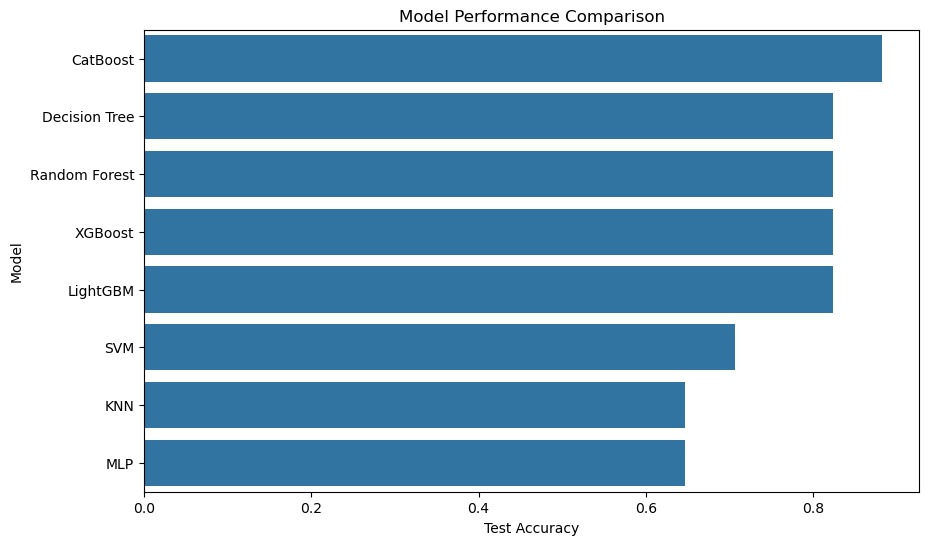

In [12]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 3, 20),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"])
        }
        model = KNeighborsClassifier(**params)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_name == "CatBoost":
        params = {
            "iterations": trial.suggest_int("iterations", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "depth": trial.suggest_int("depth", 3, 10)
        }
        model = cb.CatBoostClassifier(**params, verbose=0, random_state=42)

    elif model_name == "MLP":
        params = {
            "hidden_layer_sizes": trial.suggest_categorical("hidden_layer_sizes", [(50,), (100,), (100, 50)]),
            "alpha": trial.suggest_float("alpha", 0.0001, 0.01)
        }
        model = MLPClassifier(**params, max_iter=500, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Optimize selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "KNN", "LightGBM", "CatBoost", "MLP"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# Pretty Print Results
results_df = pd.DataFrame(results)
print("\nFinal Model Performance:\n")
print(results_df.sort_values(by="Test Accuracy", ascending=False))

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df.sort_values(by="Test Accuracy", ascending=False))
plt.title("Model Performance Comparison")
plt.show()


[I 2025-02-13 21:42:43,546] A new study created in memory with name: no-name-41d1c337-caf5-4d6f-b8b3-264d0ebd0e13
[I 2025-02-13 21:42:46,129] Trial 0 finished with value: 0.6443262411347519 and parameters: {'n_estimators': 158, 'max_depth': 7}. Best is trial 0 with value: 0.6443262411347519.
[I 2025-02-13 21:42:46,504] Trial 2 finished with value: 0.6358156028368794 and parameters: {'n_estimators': 347, 'max_depth': 9}. Best is trial 0 with value: 0.6443262411347519.
[I 2025-02-13 21:42:46,692] Trial 3 finished with value: 0.6443262411347517 and parameters: {'n_estimators': 304, 'max_depth': 10}. Best is trial 0 with value: 0.6443262411347519.
[I 2025-02-13 21:42:46,700] Trial 4 finished with value: 0.6399822695035461 and parameters: {'n_estimators': 141, 'max_depth': 13}. Best is trial 0 with value: 0.6443262411347519.
[I 2025-02-13 21:42:46,801] Trial 1 finished with value: 0.6442375886524823 and parameters: {'n_estimators': 466, 'max_depth': 14}. Best is trial 0 with value: 0.644326

Best parameters for Random Forest: {'n_estimators': 158, 'max_depth': 7}


[I 2025-02-13 21:42:47,042] Trial 1 finished with value: 0.6066489361702128 and parameters: {'n_estimators': 116, 'max_depth': 5, 'learning_rate': 0.14823049962269658}. Best is trial 1 with value: 0.6066489361702128.
[I 2025-02-13 21:42:47,060] Trial 2 finished with value: 0.6233156028368795 and parameters: {'n_estimators': 204, 'max_depth': 4, 'learning_rate': 0.20602080365428996}. Best is trial 2 with value: 0.6233156028368795.
[I 2025-02-13 21:42:47,061] Trial 3 finished with value: 0.6276595744680851 and parameters: {'n_estimators': 411, 'max_depth': 11, 'learning_rate': 0.26399447464020576}. Best is trial 3 with value: 0.6276595744680851.
[I 2025-02-13 21:42:47,071] Trial 4 finished with value: 0.6318262411347518 and parameters: {'n_estimators': 392, 'max_depth': 9, 'learning_rate': 0.25435204814820256}. Best is trial 4 with value: 0.6318262411347518.
[I 2025-02-13 21:42:47,078] Trial 0 finished with value: 0.6318262411347518 and parameters: {'n_estimators': 404, 'max_depth': 9, '

Best parameters for XGBoost: {'n_estimators': 392, 'max_depth': 9, 'learning_rate': 0.25435204814820256}
Best parameters for SVM: {'C': 3.594936360571629, 'kernel': 'rbf'}


[I 2025-02-13 21:42:50,744] Trial 1 finished with value: 0.614804964539007 and parameters: {'n_estimators': 376, 'learning_rate': 0.26814407102864996, 'num_leaves': 51}. Best is trial 1 with value: 0.614804964539007.
[I 2025-02-13 21:42:50,892] Trial 0 finished with value: 0.6024822695035461 and parameters: {'n_estimators': 441, 'learning_rate': 0.25265402408292653, 'num_leaves': 86}. Best is trial 1 with value: 0.614804964539007.
[I 2025-02-13 21:42:50,950] Trial 3 finished with value: 0.5774822695035462 and parameters: {'n_estimators': 163, 'learning_rate': 0.023093781472732118, 'num_leaves': 83}. Best is trial 1 with value: 0.614804964539007.
[I 2025-02-13 21:42:51,096] Trial 4 finished with value: 0.5814716312056738 and parameters: {'n_estimators': 268, 'learning_rate': 0.25692193596964846, 'num_leaves': 102}. Best is trial 1 with value: 0.614804964539007.
[I 2025-02-13 21:42:51,288] Trial 2 finished with value: 0.5942375886524822 and parameters: {'n_estimators': 400, 'learning_rat

Best parameters for LightGBM: {'n_estimators': 376, 'learning_rate': 0.26814407102864996, 'num_leaves': 51}
[LightGBM] [Info] Number of positive: 141, number of negative: 98
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 179
[LightGBM] [Info] Number of data points in the train set: 239, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.589958 -> initscore=0.363792
[LightGBM] [Info] Start training from score 0.363792
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

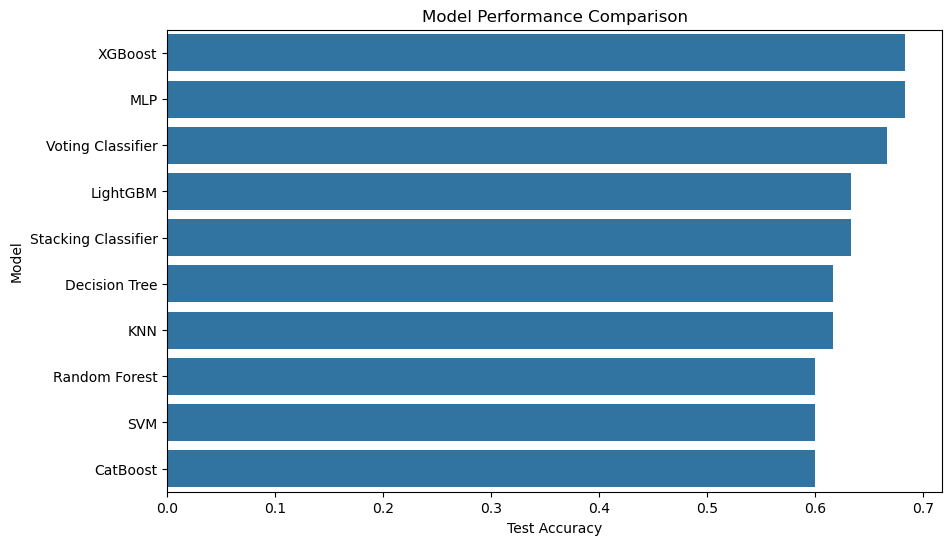

In [2]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
# X_resampled, y_resampled = smote_enn.fit_resample(X, y)
X_resampled, y_resampled = X, y

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "LightGBM"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# **STACKING CLASSIFIER**
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# **VOTING CLASSIFIER**
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Store stacking and voting results
for name, model in [("Stacking Classifier", stacking_model), ("Voting Classifier", voting_model)]:
    results.append({"Model": name, "Train Accuracy": accuracy_score(y_train, model.predict(X_train)), "Test Accuracy": accuracy_score(y_test, model.predict(X_test))})

# Pretty print results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n")
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()


In [17]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models to tune
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
import optuna

# Tuning function with error handling
def optimize_model(trial, model_name):
    try:
        params = {}

        if model_name == "Decision Tree":
            params = {"max_depth": trial.suggest_int("max_depth", 3, 15)}
            model = DecisionTreeClassifier(**params, random_state=42)

        elif model_name == "Random Forest":
            params = {
                "n_estimators": trial.suggest_int("n_estimators", 100, 500),
                "max_depth": trial.suggest_int("max_depth", 3, 15)
            }
            model = RandomForestClassifier(**params, random_state=42)

        elif model_name == "XGBoost":
            params = {
                "n_estimators": trial.suggest_int("n_estimators", 100, 500),
                "max_depth": trial.suggest_int("max_depth", 3, 15),
                "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
            }
            model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

        elif model_name == "KNN":
            params = {"n_neighbors": trial.suggest_int("n_neighbors", 3, 20)}
            model = KNeighborsClassifier(**params)

        elif model_name == "SVM":
            params = {
                "C": trial.suggest_float("C", 0.1, 10.0),
                "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
            }
            model = SVC(**params, probability=True, random_state=42)

        elif model_name == "LightGBM":
            params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 300),
            "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 20),
            "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0.0, 0.2),
            "feature_fraction": trial.suggest_float("feature_fraction", 0.5, 0.9)
            }

            model = lgb.LGBMClassifier(**params, random_state=42)

        elif model_name == "CatBoost":
            params = {
                "iterations": trial.suggest_int("iterations", 100, 500),
                "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
                "depth": trial.suggest_int("depth", 3, 10)
            }
            model = cb.CatBoostClassifier(**params, verbose=0, random_state=42)

        # Cross-validation
        score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=1).mean()
        return score

    except Exception as e:
        print(f"⚠️ Error tuning {model_name}: {str(e)}")
        return None  # Avoid breaking Optuna

# Tune all models
best_params = {}
for model_name in models.keys():
    print(f"🔍 Tuning {model_name}...")
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=50, n_jobs=1)  # Debugging with n_jobs=1

    if study.best_params:  # Ensure a valid result exists
        best_params[model_name] = study.best_params
        print(f"✅ Best parameters for {model_name}: {study.best_params}")
    else:
        print(f"❌ No valid trials for {model_name}")



# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    model.set_params(**best_params[name])
    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# Stacking & Voting Classifiers
stacking_model = StackingClassifier(estimators=list(trained_models.items()), final_estimator=LogisticRegression())
voting_model = VotingClassifier(estimators=list(trained_models.items()), voting="soft")

stacking_model.fit(X_train, y_train)
voting_model.fit(X_train, y_train)

joblib.dump(stacking_model, "StackingClassifier.joblib")
joblib.dump(voting_model, "VotingClassifier.joblib")

# Display results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print(results_df)
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.show()


[I 2025-02-13 13:30:30,386] A new study created in memory with name: no-name-2a5df2ac-58e8-404b-b2f2-fd7462dbf1e2
[I 2025-02-13 13:30:30,395] Trial 0 finished with value: 0.7500000000000001 and parameters: {'max_depth': 11}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,404] Trial 1 finished with value: 0.7333333333333333 and parameters: {'max_depth': 3}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,414] Trial 2 finished with value: 0.7500000000000001 and parameters: {'max_depth': 11}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,423] Trial 3 finished with value: 0.7500000000000001 and parameters: {'max_depth': 10}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,432] Trial 4 finished with value: 0.7500000000000001 and parameters: {'max_depth': 15}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,441] Trial 5 finished with value: 0.7500000000000001 and parameters: 

🔍 Tuning Decision Tree...


[I 2025-02-13 13:30:30,576] Trial 17 finished with value: 0.7333333333333334 and parameters: {'max_depth': 6}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,592] Trial 18 finished with value: 0.7500000000000001 and parameters: {'max_depth': 10}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,607] Trial 19 finished with value: 0.7500000000000001 and parameters: {'max_depth': 14}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,620] Trial 20 finished with value: 0.7500000000000001 and parameters: {'max_depth': 11}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,632] Trial 21 finished with value: 0.7500000000000001 and parameters: {'max_depth': 9}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,644] Trial 22 finished with value: 0.7500000000000001 and parameters: {'max_depth': 10}. Best is trial 0 with value: 0.7500000000000001.
[I 2025-02-13 13:30:30,657] Trial 23 finis

✅ Best parameters for Decision Tree: {'max_depth': 11}
🔍 Tuning Random Forest...


[I 2025-02-13 13:30:31,855] Trial 0 finished with value: 0.7833333333333333 and parameters: {'n_estimators': 223, 'max_depth': 11}. Best is trial 0 with value: 0.7833333333333333.
[I 2025-02-13 13:30:32,903] Trial 1 finished with value: 0.7833333333333333 and parameters: {'n_estimators': 286, 'max_depth': 14}. Best is trial 0 with value: 0.7833333333333333.
[I 2025-02-13 13:30:34,703] Trial 2 finished with value: 0.7333333333333333 and parameters: {'n_estimators': 493, 'max_depth': 3}. Best is trial 0 with value: 0.7833333333333333.
[I 2025-02-13 13:30:35,885] Trial 3 finished with value: 0.7333333333333333 and parameters: {'n_estimators': 332, 'max_depth': 3}. Best is trial 0 with value: 0.7833333333333333.
[I 2025-02-13 13:30:37,072] Trial 4 finished with value: 0.7666666666666667 and parameters: {'n_estimators': 328, 'max_depth': 4}. Best is trial 0 with value: 0.7833333333333333.
[I 2025-02-13 13:30:38,008] Trial 5 finished with value: 0.7833333333333333 and parameters: {'n_estimat

✅ Best parameters for Random Forest: {'n_estimators': 223, 'max_depth': 11}
🔍 Tuning XGBoost...


[I 2025-02-13 13:31:25,440] Trial 0 finished with value: 0.7333333333333333 and parameters: {'n_estimators': 383, 'max_depth': 4, 'learning_rate': 0.09803515775626259}. Best is trial 0 with value: 0.7333333333333333.
[I 2025-02-13 13:31:25,680] Trial 1 finished with value: 0.7 and parameters: {'n_estimators': 319, 'max_depth': 8, 'learning_rate': 0.1879504393887639}. Best is trial 0 with value: 0.7333333333333333.
[I 2025-02-13 13:31:25,932] Trial 2 finished with value: 0.75 and parameters: {'n_estimators': 291, 'max_depth': 12, 'learning_rate': 0.09808186103740558}. Best is trial 2 with value: 0.75.
[I 2025-02-13 13:31:26,270] Trial 3 finished with value: 0.75 and parameters: {'n_estimators': 376, 'max_depth': 10, 'learning_rate': 0.026304180377883853}. Best is trial 2 with value: 0.75.
[I 2025-02-13 13:31:26,541] Trial 4 finished with value: 0.6833333333333333 and parameters: {'n_estimators': 402, 'max_depth': 7, 'learning_rate': 0.2655955230803472}. Best is trial 2 with value: 0.75.

✅ Best parameters for XGBoost: {'n_estimators': 291, 'max_depth': 12, 'learning_rate': 0.09808186103740558}
🔍 Tuning KNN...


[I 2025-02-13 13:31:38,845] Trial 11 finished with value: 0.6 and parameters: {'n_neighbors': 4}. Best is trial 5 with value: 0.7166666666666666.
[I 2025-02-13 13:31:38,864] Trial 12 finished with value: 0.7166666666666666 and parameters: {'n_neighbors': 3}. Best is trial 5 with value: 0.7166666666666666.
[I 2025-02-13 13:31:38,882] Trial 13 finished with value: 0.5333333333333334 and parameters: {'n_neighbors': 8}. Best is trial 5 with value: 0.7166666666666666.
[I 2025-02-13 13:31:38,897] Trial 14 finished with value: 0.6166666666666666 and parameters: {'n_neighbors': 5}. Best is trial 5 with value: 0.7166666666666666.
[I 2025-02-13 13:31:38,914] Trial 15 finished with value: 0.5333333333333334 and parameters: {'n_neighbors': 8}. Best is trial 5 with value: 0.7166666666666666.
[I 2025-02-13 13:31:38,928] Trial 16 finished with value: 0.7166666666666666 and parameters: {'n_neighbors': 3}. Best is trial 5 with value: 0.7166666666666666.
[I 2025-02-13 13:31:38,944] Trial 17 finished wit

✅ Best parameters for KNN: {'n_neighbors': 3}
🔍 Tuning SVM...


[I 2025-02-13 13:31:39,654] Trial 12 finished with value: 0.8 and parameters: {'C': 8.34190085305048, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8.
[I 2025-02-13 13:31:39,670] Trial 13 finished with value: 0.8 and parameters: {'C': 8.664833436325313, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8.
[I 2025-02-13 13:31:39,687] Trial 14 finished with value: 0.7833333333333333 and parameters: {'C': 6.58693610523544, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8.
[I 2025-02-13 13:31:39,702] Trial 15 finished with value: 0.7833333333333333 and parameters: {'C': 6.303191218822867, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8.
[I 2025-02-13 13:31:39,717] Trial 16 finished with value: 0.8 and parameters: {'C': 9.0379404921173, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8.
[I 2025-02-13 13:31:39,732] Trial 17 finished with value: 0.8 and parameters: {'C': 7.237566382821525, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8.
[I 2025-02-13 13:31:39,748] Trial 18 finished with

✅ Best parameters for SVM: {'C': 7.762397481375349, 'kernel': 'rbf'}
🔍 Tuning LightGBM...
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.7481401255290276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7481401255290276
[LightGBM] [Warning] min_gain_to_split is set=0.05452419066823782, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05452419066823782
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.7481401255290276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7481401255290276
[LightGBM] [Warning] min_gain_to_split is set=0.05452419066823782, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05452419066823782
[LightGBM] [Info] Number of positive: 19, number o

[I 2025-02-13 13:31:40,485] Trial 1 finished with value: 0.5166666666666667 and parameters: {'n_estimators': 445, 'learning_rate': 0.2275904764280176, 'num_leaves': 247, 'min_data_in_leaf': 17, 'min_gain_to_split': 0.03288299510497816, 'feature_fraction': 0.5011314887902446}. Best is trial 0 with value: 0.75.
[I 2025-02-13 13:31:40,592] Trial 2 finished with value: 0.7 and parameters: {'n_estimators': 379, 'learning_rate': 0.20384257618561805, 'num_leaves': 107, 'min_data_in_leaf': 3, 'min_gain_to_split': 0.19773733598959908, 'feature_fraction': 0.7241783677539945}. Best is trial 0 with value: 0.75.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:40,814] Trial 3 finished with value: 0.7 and parameters: {'n_estimators': 443, 'learning_rate': 0.02946332320258034, 'num_leaves': 232, 'min_data_in_leaf': 9, 'min_gain_to_split': 0.08908483285166546, 'feature_fraction': 0.7248302932556379}. Best is trial 0 with value: 0.75.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:40,941] Trial 4 finished with value: 0.55 and parameters: {'n_estimators': 481, 'learning_rate': 0.1257828285899025, 'num_leaves': 284, 'min_data_in_leaf': 20, 'min_gain_to_split': 0.027719409652942662, 'feature_fraction': 0.6570652317903065}. Best is trial 0 with value: 0.75.
[I 2025-02-13 13:31:41,034] Trial 5 finished with value: 0.7666666666666667 and parameters: {'n_estimators': 168, 'learning_rate': 0.09537049054291424, 'num_leaves': 224, 'min_data_in_leaf': 11, 'min_gain_to_split': 0.1822858827203895, 'feature_fraction': 0.8432031058183158}. Best is trial 5 with value: 0.7666666666666667.


[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.6570652317903065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6570652317903065
[LightGBM] [Warning] min_gain_to_split is set=0.027719409652942662, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.027719409652942662
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.6570652317903065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6570652317903065
[LightGBM] [Warning] min_gain_to_split is set=0.027719409652942662, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.027719409652942662
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overh

[I 2025-02-13 13:31:41,130] Trial 6 finished with value: 0.7499999999999999 and parameters: {'n_estimators': 295, 'learning_rate': 0.2553122259266431, 'num_leaves': 188, 'min_data_in_leaf': 13, 'min_gain_to_split': 0.1661640339263593, 'feature_fraction': 0.6708877041846903}. Best is trial 5 with value: 0.7666666666666667.
[I 2025-02-13 13:31:41,229] Trial 7 finished with value: 0.8 and parameters: {'n_estimators': 266, 'learning_rate': 0.14831363112170787, 'num_leaves': 115, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.0037113334561612813, 'feature_fraction': 0.6892355449620305}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] feature_fraction is set=0.6708877041846903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6708877041846903
[LightGBM] [Warning] min_gain_to_split is set=0.1661640339263593, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1661640339263593
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] feature_fraction is set=0.6708877041846903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6708877041846903
[LightGBM] [Warning] min_gain_to_split is set=0.1661640339263593, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1661640339263593
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of t

[I 2025-02-13 13:31:41,377] Trial 8 finished with value: 0.7166666666666667 and parameters: {'n_estimators': 334, 'learning_rate': 0.15955376831913912, 'num_leaves': 92, 'min_data_in_leaf': 11, 'min_gain_to_split': 0.0613519047849681, 'feature_fraction': 0.6376204756658754}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] feature_fraction is set=0.6376204756658754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6376204756658754
[LightGBM] [Warning] min_gain_to_split is set=0.0613519047849681, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0613519047849681
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] feature_fraction is set=0.6376204756658754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6376204756658754
[LightGBM] [Warning] min_gain_to_split is set=0.0613519047849681, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0613519047849681
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of t

[I 2025-02-13 13:31:41,512] Trial 9 finished with value: 0.5666666666666667 and parameters: {'n_estimators': 377, 'learning_rate': 0.05627253428988919, 'num_leaves': 273, 'min_data_in_leaf': 17, 'min_gain_to_split': 0.023838186372917236, 'feature_fraction': 0.5991537056783927}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:41,600] Trial 10 finished with value: 0.6833333333333333 and parameters: {'n_estimators': 221, 'learning_rate': 0.16739303279969536, 'num_leaves': 25, 'min_data_in_leaf': 6, 'min_gain_to_split': 0.13641503874297412, 'feature_fraction': 0.8843094561636224}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:41,705] Trial 11 finished with value: 0.7333333333333334 and parameters: {'n_estimators': 101, 'learning_rate': 0.10616480109529236, 'num_leaves': 125, 'min_data_in_leaf': 7, 'min_gain_to_split': 0.12178198723423785, 'feature_fraction': 0.8385667623526166}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:41,803] Trial 12 finished with value: 0.75 and parameters: {'n_estimators': 181, 'learning_rate': 0.08082953250098444, 'num_leaves': 48, 'min_data_in_leaf': 13, 'min_gain_to_split': 0.09651276131550947, 'feature_fraction': 0.7909606710187976}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] feature_fraction is set=0.8385667623526166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8385667623526166
[LightGBM] [Warning] min_gain_to_split is set=0.12178198723423785, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.12178198723423785
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] feature_fraction is set=0.8385667623526166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8385667623526166
[LightGBM] [Warning] min_gain_to_split is set=0.12178198723423785, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.12178198723423785
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of t

[I 2025-02-13 13:31:41,996] Trial 13 finished with value: 0.7166666666666667 and parameters: {'n_estimators': 242, 'learning_rate': 0.010016810546812638, 'num_leaves': 146, 'min_data_in_leaf': 4, 'min_gain_to_split': 0.0011869552940850514, 'feature_fraction': 0.801960541673582}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=4, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4
[LightGBM] [Warning] feature_fraction is set=0.801960541673582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.801960541673582
[LightGBM] [Warning] min_gain_to_split is set=0.0011869552940850514, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0011869552940850514
[LightGBM] [Warning] min_data_in_leaf is set=4, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4
[LightGBM] [Warning] feature_fraction is set=0.801960541673582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.801960541673582
[LightGBM] [Warning] min_gain_to_split is set=0.0011869552940850514, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0011869552940850514
[LightGBM] [Warning] min_data_in_leaf is set=4, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4
[LightGBM] [Warn

[I 2025-02-13 13:31:42,116] Trial 14 finished with value: 0.75 and parameters: {'n_estimators': 149, 'learning_rate': 0.11527655965129086, 'num_leaves': 194, 'min_data_in_leaf': 9, 'min_gain_to_split': 0.19701771244605895, 'feature_fraction': 0.5529910746182851}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:42,207] Trial 15 finished with value: 0.7333333333333332 and parameters: {'n_estimators': 260, 'learning_rate': 0.18443854607390012, 'num_leaves': 71, 'min_data_in_leaf': 14, 'min_gain_to_split': 0.1585210008049684, 'feature_fraction': 0.8921158935887452}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] feature_fraction is set=0.5529910746182851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5529910746182851
[LightGBM] [Warning] min_gain_to_split is set=0.19701771244605895, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.19701771244605895
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] feature_fraction is set=0.5529910746182851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5529910746182851
[LightGBM] [Warning] min_gain_to_split is set=0.19701771244605895, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.19701771244605895
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning]

[I 2025-02-13 13:31:42,318] Trial 16 finished with value: 0.7166666666666666 and parameters: {'n_estimators': 178, 'learning_rate': 0.13628368742281669, 'num_leaves': 230, 'min_data_in_leaf': 6, 'min_gain_to_split': 0.07591423409299983, 'feature_fraction': 0.7791847581035577}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:42,441] Trial 17 finished with value: 0.7666666666666667 and parameters: {'n_estimators': 106, 'learning_rate': 0.08372096276820802, 'num_leaves': 154, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.11950097384453613, 'feature_fraction': 0.8429223068028034}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] feature_fraction is set=0.7791847581035577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7791847581035577
[LightGBM] [Warning] min_gain_to_split is set=0.07591423409299983, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.07591423409299983
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] feature_fraction is set=0.7791847581035577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7791847581035577
[LightGBM] [Warning] min_gain_to_split is set=0.07591423409299983, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.07591423409299983
[LightGBM] [Info] Number of positive: 20, number of negative: 28
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of t

[I 2025-02-13 13:31:42,572] Trial 18 finished with value: 0.7666666666666667 and parameters: {'n_estimators': 283, 'learning_rate': 0.0650722135296805, 'num_leaves': 200, 'min_data_in_leaf': 10, 'min_gain_to_split': 0.16917412645336272, 'feature_fraction': 0.6945439912355037}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:42,668] Trial 19 finished with value: 0.6833333333333333 and parameters: {'n_estimators': 205, 'learning_rate': 0.2194068881746502, 'num_leaves': 300, 'min_data_in_leaf': 4, 'min_gain_to_split': 0.14407255268704713, 'feature_fraction': 0.5934281538490002}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:42,764] Trial 20 finished with value: 0.65 and parameters: {'n_estimators': 150, 'learning_rate': 0.29825288796072835, 'num_leaves': 129, 'min_data_in_leaf': 15, 'min_gain_to_split': 0.10929151219314101, 'feature_fraction': 0.7519087302213805}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:42,844] Trial 21 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 105, 'learning_rate': 0.09620563119473002, 'num_leaves': 164, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.17783421177323852, 'feature_fraction': 0.8492598963877978}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] feature_fraction is set=0.7519087302213805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7519087302213805
[LightGBM] [Warning] min_gain_to_split is set=0.10929151219314101, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.10929151219314101
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] feature_fraction is set=0.7519087302213805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7519087302213805
[LightGBM] [Warning] min_gain_to_split is set=0.10929151219314101, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.10929151219314101
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead 

[I 2025-02-13 13:31:42,927] Trial 22 finished with value: 0.7666666666666667 and parameters: {'n_estimators': 138, 'learning_rate': 0.09754486312736596, 'num_leaves': 169, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.17821201488743213, 'feature_fraction': 0.8426093099199695}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:43,036] Trial 23 finished with value: 0.7 and parameters: {'n_estimators': 186, 'learning_rate': 0.14053315572199299, 'num_leaves': 213, 'min_data_in_leaf': 4, 'min_gain_to_split': 0.18362407004736944, 'feature_fraction': 0.817161255599666}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2025-02-13 13:31:43,139] Trial 24 finished with value: 0.7166666666666666 and parameters: {'n_estimators': 125, 'learning_rate': 0.04798024658021809, 'num_leaves': 84, 'min_data_in_leaf': 7, 'min_gain_to_split': 0.13591316717692667, 'feature_fraction': 0.8761178882879569}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:43,241] Trial 25 finished with value: 0.7499999999999999 and parameters: {'n_estimators': 224, 'learning_rate': 0.17934502128575625, 'num_leaves': 131, 'min_data_in_leaf': 11, 'min_gain_to_split': 0.1478473049353979, 'feature_fraction': 0.7643809471837442}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] feature_fraction is set=0.8761178882879569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8761178882879569
[LightGBM] [Warning] min_gain_to_split is set=0.13591316717692667, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.13591316717692667
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] feature_fraction is set=0.8761178882879569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8761178882879569
[LightGBM] [Warning] min_gain_to_split is set=0.13591316717692667, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.13591316717692667
[LightGBM] [Info] Number of positive: 20, number of negative: 28
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of t

[I 2025-02-13 13:31:43,345] Trial 26 finished with value: 0.75 and parameters: {'n_estimators': 164, 'learning_rate': 0.14972750602669568, 'num_leaves': 169, 'min_data_in_leaf': 5, 'min_gain_to_split': 0.007382010763625685, 'feature_fraction': 0.6848233103752225}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:43,469] Trial 27 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 265, 'learning_rate': 0.09333247595318216, 'num_leaves': 257, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.1843641970527621, 'feature_fraction': 0.7251130959940905}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:43,606] Trial 28 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 326, 'learning_rate': 0.12545346467437307, 'num_leaves': 263, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.04661050303605066, 'feature_fraction': 0.7118371778865102}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-02-13 13:31:43,741] Trial 29 finished with value: 0.7500000000000001 and parameters: {'n_estimators': 271, 'learning_rate': 0.07598925762320785, 'num_leaves': 59, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.0759009233836287, 'feature_fraction': 0.6370105457330254}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:43,898] Trial 30 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 322, 'learning_rate': 0.03254331947008994, 'num_leaves': 99, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.15558662781523677, 'feature_fraction': 0.7383563276332322}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-02-13 13:31:44,056] Trial 31 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 342, 'learning_rate': 0.12243693781091981, 'num_leaves': 255, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.012775466643506232, 'feature_fraction': 0.7136323617494802}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:44,223] Trial 32 finished with value: 0.7666666666666667 and parameters: {'n_estimators': 405, 'learning_rate': 0.109162986667617, 'num_leaves': 255, 'min_data_in_leaf': 3, 'min_gain_to_split': 0.04748004604375461, 'feature_fraction': 0.614572146603856}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-02-13 13:31:44,368] Trial 33 finished with value: 0.7666666666666668 and parameters: {'n_estimators': 313, 'learning_rate': 0.13426102165725362, 'num_leaves': 275, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.044273487541207836, 'feature_fraction': 0.70729217860602}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:44,505] Trial 34 finished with value: 0.7 and parameters: {'n_estimators': 255, 'learning_rate': 0.19808139558539323, 'num_leaves': 113, 'min_data_in_leaf': 3, 'min_gain_to_split': 0.06111539556537283, 'feature_fraction': 0.5592506786613405}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-02-13 13:31:44,687] Trial 35 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 413, 'learning_rate': 0.1530884288431451, 'num_leaves': 239, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.01809255549285919, 'feature_fraction': 0.7374725722240089}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.7374725722240089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7374725722240089
[LightGBM] [Warning] min_gain_to_split is set=0.01809255549285919, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01809255549285919
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.7374725722240089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7374725722240089
[LightGBM] [Warning] min_gain_to_split is set=0.01809255549285919, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01809255549285919
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of t

[I 2025-02-13 13:31:44,888] Trial 36 finished with value: 0.7166666666666667 and parameters: {'n_estimators': 493, 'learning_rate': 0.0959530332037922, 'num_leaves': 300, 'min_data_in_leaf': 3, 'min_gain_to_split': 0.19722768336429633, 'feature_fraction': 0.6542714426391206}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

[I 2025-02-13 13:31:45,062] Trial 37 finished with value: 0.7333333333333333 and parameters: {'n_estimators': 356, 'learning_rate': 0.12371550786909315, 'num_leaves': 211, 'min_data_in_leaf': 5, 'min_gain_to_split': 0.03648130456972543, 'feature_fraction': 0.677345813220858}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] feature_fraction is set=0.677345813220858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.677345813220858
[LightGBM] [Warning] min_gain_to_split is set=0.03648130456972543, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03648130456972543
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] feature_fraction is set=0.677345813220858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.677345813220858
[LightGBM] [Warning] min_gain_to_split is set=0.03648130456972543, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03648130456972543
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] fea

[I 2025-02-13 13:31:45,202] Trial 38 finished with value: 0.8 and parameters: {'n_estimators': 309, 'learning_rate': 0.07174629725519266, 'num_leaves': 263, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.07848413694115104, 'feature_fraction': 0.7621260994095087}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:45,377] Trial 39 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 297, 'learning_rate': 0.04145855438691362, 'num_leaves': 176, 'min_data_in_leaf': 3, 'min_gain_to_split': 0.0741686278275118, 'feature_fraction': 0.7630963324859092}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:45,471] Trial 40 finished with value: 0.5833333333333333 and parameters: {'n_estimators': 230, 'learning_rate': 0.06684866478976971, 'num_leaves': 142, 'min_data_in_leaf': 20, 'min_gain_to_split': 0.09210240269012139, 'feature_fraction': 0.8704870870442453}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.8704870870442453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704870870442453
[LightGBM] [Warning] min_gain_to_split is set=0.09210240269012139, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.09210240269012139
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.8704870870442453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704870870442453
[LightGBM] [Warning] min_gain_to_split is set=0.09210240269012139, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.09210240269012139
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead 

[I 2025-02-13 13:31:45,633] Trial 41 finished with value: 0.7666666666666668 and parameters: {'n_estimators': 309, 'learning_rate': 0.08995883384528901, 'num_leaves': 263, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.03847508288821483, 'feature_fraction': 0.7160427776876357}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:45,785] Trial 42 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 358, 'learning_rate': 0.10707351759900147, 'num_leaves': 279, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.05769581947569685, 'feature_fraction': 0.7350227836018585}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-02-13 13:31:45,915] Trial 43 finished with value: 0.7333333333333333 and parameters: {'n_estimators': 278, 'learning_rate': 0.06869029794434295, 'num_leaves': 244, 'min_data_in_leaf': 5, 'min_gain_to_split': 0.0821456674495163, 'feature_fraction': 0.8169838676584529}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:46,067] Trial 44 finished with value: 0.7833333333333334 and parameters: {'n_estimators': 380, 'learning_rate': 0.16230115583287688, 'num_leaves': 221, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.02868832541705235, 'feature_fraction': 0.662771932530148}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:46,226] Trial 45 finished with value: 0.75 and parameters: {'n_estimators': 462, 'learning_rate': 0.24886938901228967, 'num_leaves': 289, 'min_data_in_leaf': 3, 'min_gain_to_split': 0.06957259573783384, 'feature_fraction': 0.7005176085804399}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-13 13:31:46,464] Trial 46 finished with value: 0.7 and parameters: {'n_estimators': 329, 'learning_rate': 0.014978518849674778, 'num_leaves': 266, 'min_data_in_leaf': 4, 'min_gain_to_split': 0.11123140683368234, 'feature_fraction': 0.774362159295904}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=4, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4
[LightGBM] [Warning] feature_fraction is set=0.774362159295904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.774362159295904
[LightGBM] [Warning] min_gain_to_split is set=0.11123140683368234, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.11123140683368234
[LightGBM] [Warning] min_data_in_leaf is set=4, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4
[LightGBM] [Warning] feature_fraction is set=0.774362159295904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.774362159295904
[LightGBM] [Warning] min_gain_to_split is set=0.11123140683368234, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.11123140683368234
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testi

[I 2025-02-13 13:31:46,612] Trial 47 finished with value: 0.7500000000000001 and parameters: {'n_estimators': 247, 'learning_rate': 0.05757733063655091, 'num_leaves': 111, 'min_data_in_leaf': 7, 'min_gain_to_split': 0.0852882278163461, 'feature_fraction': 0.8012358558878543}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] feature_fraction is set=0.8012358558878543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012358558878543
[LightGBM] [Warning] min_gain_to_split is set=0.0852882278163461, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0852882278163461
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] feature_fraction is set=0.8012358558878543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012358558878543
[LightGBM] [Warning] min_gain_to_split is set=0.0852882278163461, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0852882278163461
[LightGBM] [Info] Number of positive: 19, number of negative: 29
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testi

[I 2025-02-13 13:31:46,744] Trial 48 finished with value: 0.75 and parameters: {'n_estimators': 294, 'learning_rate': 0.17927031307791258, 'num_leaves': 248, 'min_data_in_leaf': 1, 'min_gain_to_split': 0.17694119996595167, 'feature_fraction': 0.6375901963669945}. Best is trial 7 with value: 0.8.
[I 2025-02-13 13:31:46,879] Trial 49 finished with value: 0.7666666666666668 and parameters: {'n_estimators': 200, 'learning_rate': 0.1177713181232182, 'num_leaves': 233, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.0478880703829098, 'feature_fraction': 0.7526295637848782}. Best is trial 7 with value: 0.8.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-02-13 13:31:46,882] A new study created in memory with name: no-name-dbe1e1b8-8ef7-4d9a-a53b-0998688993dd


✅ Best parameters for LightGBM: {'n_estimators': 266, 'learning_rate': 0.14831363112170787, 'num_leaves': 115, 'min_data_in_leaf': 2, 'min_gain_to_split': 0.0037113334561612813, 'feature_fraction': 0.6892355449620305}
🔍 Tuning CatBoost...


[I 2025-02-13 13:31:55,313] Trial 0 finished with value: 0.8 and parameters: {'iterations': 287, 'learning_rate': 0.1905797493527284, 'depth': 10}. Best is trial 0 with value: 0.8.
[I 2025-02-13 13:31:56,856] Trial 1 finished with value: 0.7833333333333334 and parameters: {'iterations': 269, 'learning_rate': 0.1172570024837564, 'depth': 5}. Best is trial 0 with value: 0.8.
[I 2025-02-13 13:32:01,584] Trial 2 finished with value: 0.8 and parameters: {'iterations': 252, 'learning_rate': 0.14549490987921163, 'depth': 9}. Best is trial 0 with value: 0.8.
[I 2025-02-13 13:32:01,963] Trial 3 finished with value: 0.8 and parameters: {'iterations': 116, 'learning_rate': 0.07935891903646172, 'depth': 4}. Best is trial 0 with value: 0.8.
[I 2025-02-13 13:32:04,963] Trial 4 finished with value: 0.8166666666666667 and parameters: {'iterations': 333, 'learning_rate': 0.19525008222856008, 'depth': 7}. Best is trial 4 with value: 0.8166666666666667.
[I 2025-02-13 13:32:07,475] Trial 5 finished with v

✅ Best parameters for CatBoost: {'iterations': 235, 'learning_rate': 0.18369704220554978, 'depth': 5}
🔍 Tuning MLP...
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value
⚠️ Error tuning MLP: cannot access local variable 'model' where it is not associated with a value


ValueError: No trials are completed yet.

In [19]:
import pandas as pd
import numpy as np
import joblib
import optuna
import lightgbm as lgb
import catboost as cb
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.pipeline import Pipeline
# from optuna.integration import OptunaSearchCV
from concurrent.futures import ProcessPoolExecutor

# Load dataset
data = pd.read_excel("data.xlsx")

# Define features and target
selected_features = ['Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
                     'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
                     'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
                     'Dysuria(painful urination)']
target = 'bacteria'

X = data[selected_features]
y = data[target]

# Encode categorical variables
label_encoders = {}
for col in X.select_dtypes(include=['object']).columns:
    le = LabelEncoder()
    X[col] = le.fit_transform(X[col])
    label_encoders[col] = le

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale numerical features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Define models to tune
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0)
}

# Hyperparameter tuning with Optuna (parallel processing)
def tune_model(model_name):
    def objective(trial):
        params = {}
        if model_name == "Decision Tree":
            params = {"max_depth": trial.suggest_int("max_depth", 3, 15)}
            model = DecisionTreeClassifier(**params)
        elif model_name == "Random Forest":
            params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500),
                      "max_depth": trial.suggest_int("max_depth", 3, 15)}
            model = RandomForestClassifier(**params)
        elif model_name == "XGBoost":
            params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500),
                      "max_depth": trial.suggest_int("max_depth", 3, 15),
                      "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
            model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss')
        elif model_name == "KNN":
            params = {"n_neighbors": trial.suggest_int("n_neighbors", 3, 20)}
            model = KNeighborsClassifier(**params)
        elif model_name == "SVM":
            params = {"C": trial.suggest_float("C", 0.1, 10.0),
                      "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
            model = SVC(**params, probability=True)
        elif model_name == "LightGBM":
            params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500),
                      "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
                      "num_leaves": trial.suggest_int("num_leaves", 20, 300)}
            model = lgb.LGBMClassifier(**params)
        elif model_name == "CatBoost":
            params = {"iterations": trial.suggest_int("iterations", 100, 500),
                      "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
                      "depth": trial.suggest_int("depth", 3, 10)}
            model = cb.CatBoostClassifier(**params, verbose=0)
        
        return cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()

    study = optuna.create_study(direction="maximize")
    study.optimize(objective, n_trials=50, n_jobs=-1)
    return study.best_params

# Run tuning in parallel
best_params = {}
with ProcessPoolExecutor() as executor:
    results = executor.map(tune_model, models.keys())
    for model_name, params in zip(models.keys(), results):
        best_params[model_name] = params

# Train final models with best params
trained_models = {}
for model_name, model in models.items():
    if model_name in best_params:
        model.set_params(**best_params[model_name])
    model.fit(X_train, y_train)
    trained_models[model_name] = model

# MLP without tuning
mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=42)
mlp.fit(X_train, y_train)
trained_models["MLP"] = mlp

# Stacking classifier
stacking_clf = StackingClassifier(
    estimators=[
        ('rf', trained_models["Random Forest"]),
        ('xgb', trained_models["XGBoost"]),
        ('lgbm', trained_models["LightGBM"])
    ], final_estimator=LogisticRegression()
)
stacking_clf.fit(X_train, y_train)
trained_models["Stacking"] = stacking_clf

# Voting classifier
voting_clf = VotingClassifier(
    estimators=[(name, model) for name, model in trained_models.items() if name != "Stacking"], voting='hard'
)
voting_clf.fit(X_train, y_train)
trained_models["Voting"] = voting_clf

# Save all models
joblib.dump(trained_models, "models.pkl")

# Print results
print("\n\n✅ Model Performance Summary")
for model_name, model in trained_models.items():
    score = model.score(X_test, y_test)
    print(f"{model_name}: {score:.4f}")

KeyError: 'bacteria'

In [1]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}
    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)
    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)
    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)
    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune models
best_params = {}
for model_name in models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params

# Train models
trained_models = {}
results = []
for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])
    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")
    results.append({"Model": name, "Test Accuracy": accuracy_score(y_test, model.predict(X_test))})

# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# Voting Classifier
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Print Results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()


[I 2025-02-13 14:24:56,055] A new study created in memory with name: no-name-2ee9e696-e3d7-4994-9ffa-4d266117d53d
[W 2025-02-13 14:24:56,057] Trial 0 failed with parameters: {} because of the following error: UnboundLocalError("cannot access local variable 'model' where it is not associated with a value").
Traceback (most recent call last):
  File "d:\Project_assests\miniconda3\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_21816\3559127825.py", line 119, in <lambda>
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
                                 ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Aneesh PB\AppData\Local\Temp\ipykernel_21816\3559127825.py", line 112, in optimize_model
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
                    

ValueError: No trials are completed yet.

In [2]:
import optuna
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
import lightgbm as lgb
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split


# Function to Optimize Hyperparameters
def optimize_model(trial, model_name):
    print(f"Optimizing for model: {model_name}")  # Debugging line
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_name == "Decision Tree":
        params = {
            "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"]),
            "max_depth": trial.suggest_int("max_depth", 3, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5)
        }
        model = DecisionTreeClassifier(**params, random_state=42)

    elif model_name == "Logistic Regression":
        params = {
            "C": trial.suggest_float("C", 0.01, 10.0),
            "solver": trial.suggest_categorical("solver", ["lbfgs", "liblinear"])
        }
        model = LogisticRegression(**params, random_state=42, max_iter=1000)

    elif model_name == "Naive Bayes":
        model = GaussianNB()  # No hyperparameters to tune

    elif model_name == "KNN":
        params = {
            "n_neighbors": trial.suggest_int("n_neighbors", 1, 20),
            "weights": trial.suggest_categorical("weights", ["uniform", "distance"]),
            "metric": trial.suggest_categorical("metric", ["euclidean", "manhattan", "minkowski"])
        }
        model = KNeighborsClassifier(**params)

    elif model_name == "Gradient Boosting":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = GradientBoostingClassifier(**params, random_state=42)

    else:
        raise ValueError(f"Invalid model name: {model_name}")  # Ensure valid input

    # Ensure model is initialized before using
    assert model is not None, "Model initialization failed"

    # Cross-validation
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# List of Models to Tune
models_to_test = ["Random Forest", "XGBoost", "SVM", "LightGBM", "Decision Tree", 
                  "Logistic Regression", "Naive Bayes", "KNN", "Gradient Boosting"]

# Loop Through Each Model & Tune Hyperparameters
for model_name in models_to_test:
    print(f"\nStarting optimization for: {model_name}")
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)

    print(f"Best parameters for {model_name}: {study.best_params if study.best_params else 'No parameters to tune'}")
    print(f"Best accuracy for {model_name}: {study.best_value}")


[I 2025-02-13 14:59:32,439] A new study created in memory with name: no-name-fffd4f4c-44e8-4e28-8641-fdd40319fb35



Starting optimization for: Random Forest
Optimizing for model: Random Forest
Optimizing for model: Random Forest
Optimizing for model: Random Forest
Optimizing for model: Random Forest
Optimizing for model: Random Forest


[I 2025-02-13 14:59:35,580] Trial 2 finished with value: 0.8690909090909091 and parameters: {'n_estimators': 263, 'max_depth': 10}. Best is trial 2 with value: 0.8690909090909091.
[I 2025-02-13 14:59:35,709] Trial 1 finished with value: 0.8872727272727273 and parameters: {'n_estimators': 148, 'max_depth': 4}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:35,930] Trial 3 finished with value: 0.8690909090909091 and parameters: {'n_estimators': 386, 'max_depth': 13}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:35,972] Trial 4 finished with value: 0.8672727272727272 and parameters: {'n_estimators': 206, 'max_depth': 3}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:36,122] Trial 0 finished with value: 0.8872727272727273 and parameters: {'n_estimators': 483, 'max_depth': 14}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:36,124] A new study created in memory with name: no-name-5721e5e2-d562-49bc-92b8-2

Best parameters for Random Forest: {'n_estimators': 148, 'max_depth': 4}
Best accuracy for Random Forest: 0.8872727272727273

Starting optimization for: XGBoost
Optimizing for model: XGBoost
Optimizing for model: XGBoost
Optimizing for model: XGBoost
Optimizing for model: XGBoost
Optimizing for model: XGBoost


[I 2025-02-13 14:59:37,165] Trial 3 finished with value: 0.8490909090909092 and parameters: {'n_estimators': 223, 'max_depth': 3, 'learning_rate': 0.27451163231086445}. Best is trial 3 with value: 0.8490909090909092.
[I 2025-02-13 14:59:37,218] Trial 1 finished with value: 0.8872727272727273 and parameters: {'n_estimators': 106, 'max_depth': 11, 'learning_rate': 0.2505853044887556}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:37,242] Trial 0 finished with value: 0.8872727272727273 and parameters: {'n_estimators': 385, 'max_depth': 6, 'learning_rate': 0.12459143261418096}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:37,247] Trial 4 finished with value: 0.8709090909090909 and parameters: {'n_estimators': 311, 'max_depth': 14, 'learning_rate': 0.010695617641965706}. Best is trial 1 with value: 0.8872727272727273.
[I 2025-02-13 14:59:37,262] Trial 2 finished with value: 0.9072727272727272 and parameters: {'n_estimators': 445, 'max_depth': 9, 

Best parameters for XGBoost: {'n_estimators': 445, 'max_depth': 9, 'learning_rate': 0.03147543476519801}
Best accuracy for XGBoost: 0.9072727272727272

Starting optimization for: SVM
Optimizing for model: SVM
Optimizing for model: SVM
Optimizing for model: SVM
Optimizing for model: SVM
Optimizing for model: SVM
Best parameters for SVM: {'C': 2.320830815846031, 'kernel': 'linear'}
Best accuracy for SVM: 0.7363636363636363

Starting optimization for: LightGBM
Optimizing for model: LightGBM
Optimizing for model: LightGBM
Optimizing for model: LightGBM
Optimizing for model: LightGBM
Optimizing for model: LightGBM


[I 2025-02-13 14:59:41,965] Trial 3 finished with value: 0.5454545454545455 and parameters: {'n_estimators': 379, 'learning_rate': 0.28265694927321167, 'num_leaves': 22}. Best is trial 3 with value: 0.5454545454545455.
[I 2025-02-13 14:59:41,967] Trial 2 finished with value: 0.5454545454545455 and parameters: {'n_estimators': 135, 'learning_rate': 0.1112058536153491, 'num_leaves': 121}. Best is trial 3 with value: 0.5454545454545455.
[I 2025-02-13 14:59:42,062] Trial 1 finished with value: 0.5454545454545455 and parameters: {'n_estimators': 482, 'learning_rate': 0.20429720524811665, 'num_leaves': 129}. Best is trial 3 with value: 0.5454545454545455.
[I 2025-02-13 14:59:42,072] Trial 4 finished with value: 0.5454545454545455 and parameters: {'n_estimators': 232, 'learning_rate': 0.18431015973097656, 'num_leaves': 113}. Best is trial 3 with value: 0.5454545454545455.
[I 2025-02-13 14:59:42,080] Trial 0 finished with value: 0.5454545454545455 and parameters: {'n_estimators': 343, 'learnin

Best parameters for LightGBM: {'n_estimators': 379, 'learning_rate': 0.28265694927321167, 'num_leaves': 22}
Best accuracy for LightGBM: 0.5454545454545455

Starting optimization for: Decision Tree
Optimizing for model: Decision Tree
Optimizing for model: Decision Tree
Optimizing for model: Decision Tree
Optimizing for model: Decision Tree
Optimizing for model: Decision Tree
Best parameters for Decision Tree: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 4, 'min_samples_leaf': 1}
Best accuracy for Decision Tree: 0.9054545454545455

Starting optimization for: Logistic Regression
Optimizing for model: Logistic Regression
Optimizing for model: Logistic Regression
Optimizing for model: Logistic Regression
Optimizing for model: Logistic Regression
Optimizing for model: Logistic Regression
Best parameters for Logistic Regression: {'C': 2.396830758890361, 'solver': 'liblinear'}
Best accuracy for Logistic Regression: 0.6981818181818181

Starting optimization for: Naive Bayes
Optim

[I 2025-02-13 14:59:42,281] Trial 3 finished with value: 0.5654545454545454 and parameters: {}. Best is trial 3 with value: 0.5654545454545454.
[I 2025-02-13 14:59:42,285] Trial 4 finished with value: 0.5654545454545454 and parameters: {}. Best is trial 3 with value: 0.5654545454545454.
[I 2025-02-13 14:59:42,286] Trial 0 finished with value: 0.5654545454545454 and parameters: {}. Best is trial 3 with value: 0.5654545454545454.
[I 2025-02-13 14:59:42,286] Trial 1 finished with value: 0.5654545454545454 and parameters: {}. Best is trial 3 with value: 0.5654545454545454.
[I 2025-02-13 14:59:42,286] Trial 2 finished with value: 0.5654545454545454 and parameters: {}. Best is trial 3 with value: 0.5654545454545454.
[I 2025-02-13 14:59:42,292] A new study created in memory with name: no-name-b1f5eeb0-517c-4363-a248-65addeff85fb
[I 2025-02-13 14:59:42,348] Trial 1 finished with value: 0.6054545454545455 and parameters: {'n_neighbors': 12, 'weights': 'uniform', 'metric': 'euclidean'}. Best is 

Best parameters for Naive Bayes: No parameters to tune
Best accuracy for Naive Bayes: 0.5654545454545454

Starting optimization for: KNN
Optimizing for model: KNN
Optimizing for model: KNN
Optimizing for model: KNN
Optimizing for model: KNN
Optimizing for model: KNN
Best parameters for KNN: {'n_neighbors': 13, 'weights': 'distance', 'metric': 'manhattan'}
Best accuracy for KNN: 0.6781818181818182

Starting optimization for: Gradient Boosting
Optimizing for model: Gradient Boosting
Optimizing for model: Gradient Boosting
Optimizing for model: Gradient Boosting
Optimizing for model: Gradient Boosting
Optimizing for model: Gradient Boosting


[I 2025-02-13 14:59:42,815] Trial 0 finished with value: 0.9054545454545455 and parameters: {'n_estimators': 369, 'learning_rate': 0.14275254061989695, 'max_depth': 14}. Best is trial 0 with value: 0.9054545454545455.
[I 2025-02-13 14:59:42,823] Trial 1 finished with value: 0.9236363636363636 and parameters: {'n_estimators': 340, 'learning_rate': 0.0899250859544341, 'max_depth': 12}. Best is trial 1 with value: 0.9236363636363636.
[I 2025-02-13 14:59:42,833] Trial 3 finished with value: 0.9054545454545455 and parameters: {'n_estimators': 139, 'learning_rate': 0.2621489883212435, 'max_depth': 9}. Best is trial 1 with value: 0.9236363636363636.
[I 2025-02-13 14:59:42,888] Trial 2 finished with value: 0.9054545454545455 and parameters: {'n_estimators': 210, 'learning_rate': 0.21040355257108515, 'max_depth': 15}. Best is trial 1 with value: 0.9236363636363636.
[I 2025-02-13 14:59:43,027] Trial 4 finished with value: 0.9054545454545455 and parameters: {'n_estimators': 489, 'learning_rate': 

Best parameters for Gradient Boosting: {'n_estimators': 340, 'learning_rate': 0.0899250859544341, 'max_depth': 12}
Best accuracy for Gradient Boosting: 0.9236363636363636


In [ ]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "num_leaves": trial.suggest_int("num_leaves", 20, 150)}
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_name == "KNN":
        params = {"n_neighbors": trial.suggest_int("n_neighbors", 1, 20)}
        model = KNeighborsClassifier(**params)

    elif model_name == "Gradient Boosting":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = GradientBoostingClassifier(**params, random_state=42)

    else:
        model = models[model_name]

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params if study.best_params else {}
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# Voting Classifier
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Display results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n", results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "num_leaves": trial.suggest_int("num_leaves", 20, 150)}
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_name == "KNN":
        params = {"n_neighbors": trial.suggest_int("n_neighbors", 1, 20)}
        model = KNeighborsClassifier(**params)

    elif model_name == "Gradient Boosting":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = GradientBoostingClassifier(**params, random_state=42)

    else:
        model = models[model_name]

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models except MLP
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params if study.best_params else {}
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])
    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")


In [3]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import (RandomForestClassifier, StackingClassifier, VotingClassifier, 
                              GradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "num_leaves": trial.suggest_int("num_leaves", 20, 150)}
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_name == "KNN":
        params = {"n_neighbors": trial.suggest_int("n_neighbors", 1, 20)}
        model = KNeighborsClassifier(**params)

    elif model_name == "Gradient Boosting":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = GradientBoostingClassifier(**params, random_state=42)

    else:
        model = models[model_name]

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models and print results
for name, model in models.items():
    model.set_params(**best_params[name])
    model.fit(X_train, y_train)
    joblib.dump(model, f"{name}.joblib")

    y_pred = model.predict(X_test)
    print(f"\n{name} Classification Report:\n", classification_report(y_test, y_pred))

# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

print("\nStacking Classifier Classification Report:\n", classification_report(y_test, stacking_model.predict(X_test)))

# Voting Classifier
voting_model = VotingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

print("\nVoting Classifier Classification Report:\n", classification_report(y_test, voting_model.predict(X_test)))


[I 2025-02-13 17:19:41,672] A new study created in memory with name: no-name-ccbc0cdf-e36b-4729-bef9-84aa78ccfd84
[I 2025-02-13 17:19:51,563] Trial 1 finished with value: 0.7090909090909092 and parameters: {}. Best is trial 1 with value: 0.7090909090909092.
[I 2025-02-13 17:19:51,582] Trial 4 finished with value: 0.690909090909091 and parameters: {}. Best is trial 1 with value: 0.7090909090909092.
[I 2025-02-13 17:19:51,596] Trial 0 finished with value: 0.7090909090909091 and parameters: {}. Best is trial 1 with value: 0.7090909090909092.
[I 2025-02-13 17:19:51,614] Trial 2 finished with value: 0.7090909090909092 and parameters: {}. Best is trial 1 with value: 0.7090909090909092.
[I 2025-02-13 17:19:51,616] Trial 3 finished with value: 0.6909090909090909 and parameters: {}. Best is trial 1 with value: 0.7090909090909092.
[I 2025-02-13 17:19:51,619] A new study created in memory with name: no-name-8f0cd4e3-0f55-4667-a307-f17089534519


Best parameters for Decision Tree: {}


[I 2025-02-13 17:19:52,373] Trial 1 finished with value: 0.8545454545454545 and parameters: {'n_estimators': 373, 'max_depth': 8}. Best is trial 1 with value: 0.8545454545454545.
[I 2025-02-13 17:19:52,479] Trial 0 finished with value: 0.8545454545454545 and parameters: {'n_estimators': 439, 'max_depth': 9}. Best is trial 1 with value: 0.8545454545454545.
[I 2025-02-13 17:19:52,518] Trial 2 finished with value: 0.8727272727272727 and parameters: {'n_estimators': 167, 'max_depth': 8}. Best is trial 2 with value: 0.8727272727272727.
[I 2025-02-13 17:19:52,528] Trial 3 finished with value: 0.8909090909090909 and parameters: {'n_estimators': 262, 'max_depth': 11}. Best is trial 3 with value: 0.8909090909090909.
[I 2025-02-13 17:19:52,618] Trial 4 finished with value: 0.8909090909090909 and parameters: {'n_estimators': 282, 'max_depth': 14}. Best is trial 3 with value: 0.8909090909090909.
[I 2025-02-13 17:19:52,620] A new study created in memory with name: no-name-bd1ce30b-be0c-47ce-ab74-c3

Best parameters for Random Forest: {'n_estimators': 262, 'max_depth': 11}


[I 2025-02-13 17:19:53,621] Trial 4 finished with value: 0.7090909090909092 and parameters: {'n_estimators': 142, 'max_depth': 12, 'learning_rate': 0.19626761786282731}. Best is trial 4 with value: 0.7090909090909092.
[I 2025-02-13 17:19:53,660] Trial 2 finished with value: 0.690909090909091 and parameters: {'n_estimators': 224, 'max_depth': 15, 'learning_rate': 0.09141574085223061}. Best is trial 4 with value: 0.7090909090909092.
[I 2025-02-13 17:19:53,666] Trial 1 finished with value: 0.7454545454545455 and parameters: {'n_estimators': 220, 'max_depth': 8, 'learning_rate': 0.17377172523245552}. Best is trial 1 with value: 0.7454545454545455.
[I 2025-02-13 17:19:53,671] Trial 3 finished with value: 0.7636363636363637 and parameters: {'n_estimators': 225, 'max_depth': 5, 'learning_rate': 0.29017175499724346}. Best is trial 3 with value: 0.7636363636363637.
[I 2025-02-13 17:19:53,675] Trial 0 finished with value: 0.7090909090909092 and parameters: {'n_estimators': 337, 'max_depth': 9, '

Best parameters for XGBoost: {'n_estimators': 225, 'max_depth': 5, 'learning_rate': 0.29017175499724346}
Best parameters for KNN: {'n_neighbors': 6}
Best parameters for SVM: {'C': 0.48009472966517674, 'kernel': 'linear'}


[I 2025-02-13 17:19:56,777] Trial 2 finished with value: 0.5636363636363636 and parameters: {'n_estimators': 357, 'learning_rate': 0.21595991930352032, 'num_leaves': 150}. Best is trial 2 with value: 0.5636363636363636.
[I 2025-02-13 17:19:56,869] Trial 4 finished with value: 0.5636363636363636 and parameters: {'n_estimators': 348, 'learning_rate': 0.12025787306125998, 'num_leaves': 144}. Best is trial 2 with value: 0.5636363636363636.
[I 2025-02-13 17:19:57,366] Trial 1 finished with value: 0.5454545454545454 and parameters: {'n_estimators': 118, 'learning_rate': 0.21773536934545734, 'num_leaves': 110}. Best is trial 2 with value: 0.5636363636363636.
[I 2025-02-13 17:19:57,502] Trial 0 finished with value: 0.5454545454545454 and parameters: {'n_estimators': 447, 'learning_rate': 0.055462305695869366, 'num_leaves': 53}. Best is trial 2 with value: 0.5636363636363636.
[I 2025-02-13 17:19:57,503] Trial 3 finished with value: 0.5636363636363636 and parameters: {'n_estimators': 457, 'learn

Best parameters for LightGBM: {'n_estimators': 357, 'learning_rate': 0.21595991930352032, 'num_leaves': 150}


[I 2025-02-13 17:20:09,211] Trial 1 finished with value: 0.7636363636363637 and parameters: {}. Best is trial 1 with value: 0.7636363636363637.
[I 2025-02-13 17:20:09,317] Trial 0 finished with value: 0.7636363636363637 and parameters: {}. Best is trial 1 with value: 0.7636363636363637.
[I 2025-02-13 17:20:11,251] Trial 2 finished with value: 0.7636363636363637 and parameters: {}. Best is trial 1 with value: 0.7636363636363637.
[I 2025-02-13 17:20:11,271] Trial 3 finished with value: 0.7636363636363637 and parameters: {}. Best is trial 1 with value: 0.7636363636363637.
[I 2025-02-13 17:20:11,325] Trial 4 finished with value: 0.7636363636363637 and parameters: {}. Best is trial 1 with value: 0.7636363636363637.
[I 2025-02-13 17:20:11,327] A new study created in memory with name: no-name-681bee7c-c8de-46a4-ae03-901e4285424f


Best parameters for CatBoost: {}


[I 2025-02-13 17:20:11,682] Trial 0 finished with value: 0.7818181818181819 and parameters: {}. Best is trial 0 with value: 0.7818181818181819.
[I 2025-02-13 17:20:11,692] Trial 3 finished with value: 0.7636363636363636 and parameters: {}. Best is trial 0 with value: 0.7818181818181819.
[I 2025-02-13 17:20:11,755] Trial 4 finished with value: 0.7818181818181819 and parameters: {}. Best is trial 0 with value: 0.7818181818181819.
[I 2025-02-13 17:20:11,778] Trial 2 finished with value: 0.8 and parameters: {}. Best is trial 2 with value: 0.8.
[I 2025-02-13 17:20:11,799] Trial 1 finished with value: 0.8 and parameters: {}. Best is trial 2 with value: 0.8.
[I 2025-02-13 17:20:11,801] A new study created in memory with name: no-name-3910aa1c-4907-4e1b-a90c-f04f31084c66
[I 2025-02-13 17:20:11,838] Trial 1 finished with value: 0.6727272727272727 and parameters: {}. Best is trial 1 with value: 0.6727272727272727.
[I 2025-02-13 17:20:11,845] Trial 0 finished with value: 0.6727272727272727 and pa

Best parameters for MLP: {}
Best parameters for Naive Bayes: {}


[I 2025-02-13 17:20:12,168] Trial 3 finished with value: 0.7818181818181819 and parameters: {'n_estimators': 159, 'learning_rate': 0.13216699907235335, 'max_depth': 4}. Best is trial 3 with value: 0.7818181818181819.
[I 2025-02-13 17:20:12,181] Trial 0 finished with value: 0.6727272727272727 and parameters: {'n_estimators': 244, 'learning_rate': 0.12695025324835618, 'max_depth': 12}. Best is trial 3 with value: 0.7818181818181819.
[I 2025-02-13 17:20:12,285] Trial 1 finished with value: 0.8 and parameters: {'n_estimators': 284, 'learning_rate': 0.0888051188358507, 'max_depth': 4}. Best is trial 1 with value: 0.8.
[I 2025-02-13 17:20:12,307] Trial 2 finished with value: 0.690909090909091 and parameters: {'n_estimators': 228, 'learning_rate': 0.2894810652795163, 'max_depth': 14}. Best is trial 1 with value: 0.8.
[I 2025-02-13 17:20:12,517] Trial 4 finished with value: 0.8181818181818181 and parameters: {'n_estimators': 393, 'learning_rate': 0.03502553709701646, 'max_depth': 4}. Best is t

Best parameters for Gradient Boosting: {'n_estimators': 393, 'learning_rate': 0.03502553709701646, 'max_depth': 4}

Decision Tree Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.88      0.88         8
           1       0.83      0.83      0.83         6

    accuracy                           0.86        14
   macro avg       0.85      0.85      0.85        14
weighted avg       0.86      0.86      0.86        14


Random Forest Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.88      0.93         8
           1       0.86      1.00      0.92         6

    accuracy                           0.93        14
   macro avg       0.93      0.94      0.93        14
weighted avg       0.94      0.93      0.93        14


XGBoost Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.75      0.80         8
           

In [9]:
X_resampled.shape

(69, 14)

In [ ]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import ADASYN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import (RandomForestClassifier, StackingClassifier, VotingClassifier, 
                              GradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using ADASYN
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "num_leaves": trial.suggest_int("num_leaves", 20, 150)}
        model = lgb.LGBMClassifier(**params, random_state=42)

    else:
        model = models[model_name]

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models and print results
for name, model in models.items():
    model.set_params(**best_params[name])
    model.fit(X_train, y_train)
    joblib.dump(model, f"{name}.joblib")

    y_pred = model.predict(X_test)
    print(f"\n{name} Classification Report:\n", classification_report(y_test, y_pred))

# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

print("\nStacking Classifier Classification Report:\n", classification_report(y_test, stacking_model.predict(X_test)))

# Voting Classifier
voting_model = VotingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

print("\nVoting Classifier Classification Report:\n", classification_report(y_test, voting_model.predict(X_test)))




[I 2025-02-13 19:11:45,241] A new study created in memory with name: no-name-6687fd67-6278-4cf9-926c-179cdf88b97e
[I 2025-02-13 19:11:47,917] Trial 3 finished with value: 0.6482828282828283 and parameters: {}. Best is trial 3 with value: 0.6482828282828283.
[I 2025-02-13 19:11:47,927] Trial 1 finished with value: 0.6485521885521885 and parameters: {}. Best is trial 1 with value: 0.6485521885521885.
[I 2025-02-13 19:11:47,940] Trial 0 finished with value: 0.62996632996633 and parameters: {}. Best is trial 1 with value: 0.6485521885521885.
[I 2025-02-13 19:11:47,980] Trial 4 finished with value: 0.6373063973063974 and parameters: {}. Best is trial 1 with value: 0.6485521885521885.
[I 2025-02-13 19:11:47,986] Trial 2 finished with value: 0.6482828282828283 and parameters: {}. Best is trial 1 with value: 0.6485521885521885.
[I 2025-02-13 19:11:47,990] A new study created in memory with name: no-name-5047ca1f-de62-49da-bcae-13d4c1c42099


Best parameters for Decision Tree: {}


[I 2025-02-13 19:11:48,712] Trial 0 finished with value: 0.6811447811447812 and parameters: {'n_estimators': 286, 'max_depth': 15}. Best is trial 0 with value: 0.6811447811447812.
[I 2025-02-13 19:11:48,847] Trial 1 finished with value: 0.681010101010101 and parameters: {'n_estimators': 371, 'max_depth': 14}. Best is trial 0 with value: 0.6811447811447812.
[I 2025-02-13 19:11:48,936] Trial 4 finished with value: 0.6665993265993266 and parameters: {'n_estimators': 186, 'max_depth': 4}. Best is trial 0 with value: 0.6811447811447812.
[I 2025-02-13 19:11:49,001] Trial 2 finished with value: 0.6739393939393938 and parameters: {'n_estimators': 242, 'max_depth': 6}. Best is trial 0 with value: 0.6811447811447812.
[I 2025-02-13 19:11:49,026] Trial 3 finished with value: 0.6845791245791246 and parameters: {'n_estimators': 307, 'max_depth': 7}. Best is trial 3 with value: 0.6845791245791246.
[I 2025-02-13 19:11:49,029] A new study created in memory with name: no-name-f873930b-6573-4d26-8a36-54d

Best parameters for Random Forest: {'n_estimators': 307, 'max_depth': 7}


[I 2025-02-13 19:11:49,892] Trial 3 finished with value: 0.6626936026936028 and parameters: {'n_estimators': 110, 'max_depth': 15, 'learning_rate': 0.12838589078872764}. Best is trial 3 with value: 0.6626936026936028.
[I 2025-02-13 19:11:49,916] Trial 1 finished with value: 0.6408080808080808 and parameters: {'n_estimators': 383, 'max_depth': 6, 'learning_rate': 0.04492291808085941}. Best is trial 3 with value: 0.6626936026936028.
[I 2025-02-13 19:11:49,957] Trial 0 finished with value: 0.6371043771043772 and parameters: {'n_estimators': 202, 'max_depth': 14, 'learning_rate': 0.1390512052550861}. Best is trial 3 with value: 0.6626936026936028.
[I 2025-02-13 19:11:49,965] Trial 4 finished with value: 0.6519191919191918 and parameters: {'n_estimators': 482, 'max_depth': 6, 'learning_rate': 0.22982657437893747}. Best is trial 3 with value: 0.6626936026936028.
[I 2025-02-13 19:11:49,976] Trial 2 finished with value: 0.6371717171717172 and parameters: {'n_estimators': 459, 'max_depth': 7, '

Best parameters for XGBoost: {'n_estimators': 110, 'max_depth': 15, 'learning_rate': 0.12838589078872764}
Best parameters for KNN: {}
Best parameters for SVM: {'C': 5.881951850786885, 'kernel': 'rbf'}


: 

In [1]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import ADASYN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import (RandomForestClassifier, StackingClassifier, VotingClassifier, 
                              GradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using ADASYN
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}
    
    if model_name == "Decision Tree":
        params = {"max_depth": trial.suggest_int("max_depth", 3, 20)}
        model = DecisionTreeClassifier(**params, random_state=42)
    
    elif model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)
    
    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)
    
    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)
    
    elif model_name == "LightGBM":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "num_leaves": trial.suggest_int("num_leaves", 20, 150)}
        model = lgb.LGBMClassifier(**params, random_state=42)
    
    elif model_name == "KNN":
        params = {"n_neighbors": trial.suggest_int("n_neighbors", 1, 20)}
        model = KNeighborsClassifier(**params)
    
    elif model_name == "Gradient Boosting":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = GradientBoostingClassifier(**params, random_state=42)
    
    elif model_name == "MLP":
        params = {"hidden_layer_sizes": trial.suggest_categorical("hidden_layer_sizes", [(50,), (100,), (50,50)]), "alpha": trial.suggest_float("alpha", 0.0001, 0.1)}
        model = MLPClassifier(**params, max_iter=500)
    
    else:
        model = models[model_name]

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")


# Train models and print results
for name, model in models.items():
    model.set_params(**best_params[name])
    model.fit(X_train, y_train)
    joblib.dump(model, f"{name}.joblib")

    y_pred = model.predict(X_test)
    print(f"\n{name} Classification Report:\n", classification_report(y_test, y_pred))

# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

print("\nStacking Classifier Classification Report:\n", classification_report(y_test, stacking_model.predict(X_test)))

# Voting Classifier
voting_model = VotingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

print("\nVoting Classifier Classification Report:\n", classification_report(y_test, voting_model.predict(X_test)))

[I 2025-02-13 19:31:27,221] A new study created in memory with name: no-name-92a23590-a8c0-402e-8980-7df2cda7585d
[I 2025-02-13 19:31:28,809] Trial 0 finished with value: 0.6298316498316497 and parameters: {'max_depth': 8}. Best is trial 0 with value: 0.6298316498316497.
[I 2025-02-13 19:31:29,869] Trial 1 finished with value: 0.6812121212121213 and parameters: {'max_depth': 3}. Best is trial 1 with value: 0.6812121212121213.
[I 2025-02-13 19:31:30,936] Trial 2 finished with value: 0.6336700336700337 and parameters: {'max_depth': 4}. Best is trial 1 with value: 0.6812121212121213.
[I 2025-02-13 19:31:31,858] Trial 3 finished with value: 0.6004040404040405 and parameters: {'max_depth': 11}. Best is trial 1 with value: 0.6812121212121213.
[I 2025-02-13 19:31:31,874] Trial 4 finished with value: 0.6004713804713805 and parameters: {'max_depth': 17}. Best is trial 1 with value: 0.6812121212121213.
[I 2025-02-13 19:31:31,875] A new study created in memory with name: no-name-828ada04-0771-403

Best parameters for Decision Tree: {'max_depth': 3}


[I 2025-02-13 19:31:32,193] Trial 0 finished with value: 0.6626936026936028 and parameters: {'n_estimators': 260, 'max_depth': 15}. Best is trial 0 with value: 0.6626936026936028.
[I 2025-02-13 19:31:32,481] Trial 1 finished with value: 0.6663299663299662 and parameters: {'n_estimators': 234, 'max_depth': 12}. Best is trial 1 with value: 0.6663299663299662.
[I 2025-02-13 19:31:32,974] Trial 2 finished with value: 0.6372390572390572 and parameters: {'n_estimators': 483, 'max_depth': 3}. Best is trial 1 with value: 0.6663299663299662.
[I 2025-02-13 19:31:33,124] Trial 3 finished with value: 0.6845791245791246 and parameters: {'n_estimators': 111, 'max_depth': 10}. Best is trial 3 with value: 0.6845791245791246.
[I 2025-02-13 19:31:33,380] Trial 4 finished with value: 0.659057239057239 and parameters: {'n_estimators': 221, 'max_depth': 15}. Best is trial 3 with value: 0.6845791245791246.
[I 2025-02-13 19:31:33,380] A new study created in memory with name: no-name-afba7105-75cd-4c00-a377-e

Best parameters for Random Forest: {'n_estimators': 111, 'max_depth': 10}


[I 2025-02-13 19:31:33,814] Trial 0 finished with value: 0.6334680134680134 and parameters: {'n_estimators': 428, 'max_depth': 8, 'learning_rate': 0.1356377971279056}. Best is trial 0 with value: 0.6334680134680134.
[I 2025-02-13 19:31:34,257] Trial 1 finished with value: 0.6408080808080808 and parameters: {'n_estimators': 437, 'max_depth': 10, 'learning_rate': 0.02377383929879741}. Best is trial 1 with value: 0.6408080808080808.
[I 2025-02-13 19:31:34,617] Trial 2 finished with value: 0.6224242424242423 and parameters: {'n_estimators': 260, 'max_depth': 10, 'learning_rate': 0.16615448452648288}. Best is trial 1 with value: 0.6408080808080808.
[I 2025-02-13 19:31:34,830] Trial 3 finished with value: 0.6369023569023569 and parameters: {'n_estimators': 245, 'max_depth': 6, 'learning_rate': 0.06639881093294049}. Best is trial 1 with value: 0.6408080808080808.
[I 2025-02-13 19:31:34,921] Trial 4 finished with value: 0.6043097643097644 and parameters: {'n_estimators': 314, 'max_depth': 4, '

Best parameters for XGBoost: {'n_estimators': 437, 'max_depth': 10, 'learning_rate': 0.02377383929879741}
Best parameters for KNN: {'n_neighbors': 5}


[I 2025-02-13 19:31:35,186] Trial 2 finished with value: 0.6228956228956228 and parameters: {'C': 4.9336838272121515, 'kernel': 'linear'}. Best is trial 1 with value: 0.6701683501683502.
[I 2025-02-13 19:31:35,242] Trial 3 finished with value: 0.6265319865319865 and parameters: {'C': 5.720314805947756, 'kernel': 'linear'}. Best is trial 1 with value: 0.6701683501683502.
[I 2025-02-13 19:31:35,278] Trial 4 finished with value: 0.6665319865319865 and parameters: {'C': 7.533619075051737, 'kernel': 'rbf'}. Best is trial 1 with value: 0.6701683501683502.
[I 2025-02-13 19:31:35,279] A new study created in memory with name: no-name-a204eaef-5fb0-423a-a52c-fc498c66d94a


Best parameters for SVM: {'C': 9.200948351293837, 'kernel': 'rbf'}


[I 2025-02-13 19:31:37,194] Trial 0 finished with value: 0.6078787878787879 and parameters: {'n_estimators': 238, 'learning_rate': 0.04135405329369073, 'num_leaves': 147}. Best is trial 0 with value: 0.6078787878787879.
[I 2025-02-13 19:31:39,020] Trial 1 finished with value: 0.6078787878787878 and parameters: {'n_estimators': 382, 'learning_rate': 0.05230044252286714, 'num_leaves': 133}. Best is trial 0 with value: 0.6078787878787879.
[I 2025-02-13 19:31:40,585] Trial 2 finished with value: 0.6077441077441077 and parameters: {'n_estimators': 185, 'learning_rate': 0.23251398491742717, 'num_leaves': 94}. Best is trial 0 with value: 0.6078787878787879.
[I 2025-02-13 19:31:41,851] Trial 3 finished with value: 0.63003367003367 and parameters: {'n_estimators': 458, 'learning_rate': 0.23811212649762845, 'num_leaves': 26}. Best is trial 3 with value: 0.63003367003367.
[I 2025-02-13 19:31:42,097] Trial 4 finished with value: 0.6114478114478115 and parameters: {'n_estimators': 244, 'learning_ra

Best parameters for LightGBM: {'n_estimators': 458, 'learning_rate': 0.23811212649762845, 'num_leaves': 26}


[I 2025-02-13 19:31:44,820] Trial 0 finished with value: 0.6518518518518519 and parameters: {}. Best is trial 0 with value: 0.6518518518518519.
[I 2025-02-13 19:31:47,545] Trial 1 finished with value: 0.6518518518518519 and parameters: {}. Best is trial 0 with value: 0.6518518518518519.
[I 2025-02-13 19:31:50,258] Trial 2 finished with value: 0.6518518518518519 and parameters: {}. Best is trial 0 with value: 0.6518518518518519.
[I 2025-02-13 19:31:52,695] Trial 3 finished with value: 0.6518518518518519 and parameters: {}. Best is trial 0 with value: 0.6518518518518519.
[I 2025-02-13 19:31:54,729] Trial 4 finished with value: 0.6518518518518519 and parameters: {}. Best is trial 0 with value: 0.6518518518518519.
[I 2025-02-13 19:31:54,730] A new study created in memory with name: no-name-eeb71446-ed9c-4ee3-85b6-7fddb9c1f13a


Best parameters for CatBoost: {}


[I 2025-02-13 19:31:55,457] Trial 0 finished with value: 0.5678114478114478 and parameters: {'hidden_layer_sizes': (50, 50), 'alpha': 0.044393426823566666}. Best is trial 0 with value: 0.5678114478114478.
[I 2025-02-13 19:31:56,005] Trial 1 finished with value: 0.5932659932659934 and parameters: {'hidden_layer_sizes': (50, 50), 'alpha': 0.033638855383731896}. Best is trial 1 with value: 0.5932659932659934.
[I 2025-02-13 19:31:56,365] Trial 2 finished with value: 0.6445791245791245 and parameters: {'hidden_layer_sizes': (50,), 'alpha': 0.07846535875874805}. Best is trial 2 with value: 0.6445791245791245.
[I 2025-02-13 19:31:56,805] Trial 3 finished with value: 0.6119191919191919 and parameters: {'hidden_layer_sizes': (100,), 'alpha': 0.007852860332907092}. Best is trial 2 with value: 0.6445791245791245.
[I 2025-02-13 19:31:57,132] Trial 4 finished with value: 0.6591919191919191 and parameters: {'hidden_layer_sizes': (50,), 'alpha': 0.011908266468198331}. Best is trial 4 with value: 0.65

Best parameters for MLP: {'hidden_layer_sizes': (50,), 'alpha': 0.011908266468198331}
Best parameters for Naive Bayes: {}


[I 2025-02-13 19:31:57,907] Trial 0 finished with value: 0.5896296296296296 and parameters: {'n_estimators': 336, 'learning_rate': 0.19742248918010205, 'max_depth': 9}. Best is trial 0 with value: 0.5896296296296296.
[I 2025-02-13 19:31:58,286] Trial 1 finished with value: 0.5931313131313131 and parameters: {'n_estimators': 113, 'learning_rate': 0.2115556754275164, 'max_depth': 12}. Best is trial 1 with value: 0.5931313131313131.
[I 2025-02-13 19:31:58,740] Trial 2 finished with value: 0.6187878787878788 and parameters: {'n_estimators': 435, 'learning_rate': 0.21457408780439025, 'max_depth': 15}. Best is trial 2 with value: 0.6187878787878788.
[I 2025-02-13 19:31:59,080] Trial 3 finished with value: 0.6261279461279461 and parameters: {'n_estimators': 246, 'learning_rate': 0.24703775249158452, 'max_depth': 15}. Best is trial 3 with value: 0.6261279461279461.
[I 2025-02-13 19:31:59,847] Trial 4 finished with value: 0.6224242424242423 and parameters: {'n_estimators': 441, 'learning_rate':

Best parameters for Gradient Boosting: {'n_estimators': 246, 'learning_rate': 0.24703775249158452, 'max_depth': 15}

Decision Tree Classification Report:
               precision    recall  f1-score   support

           0       0.61      0.67      0.64        33
           1       0.67      0.61      0.64        36

    accuracy                           0.64        69
   macro avg       0.64      0.64      0.64        69
weighted avg       0.64      0.64      0.64        69


Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.77      0.70      0.73        33
           1       0.74      0.81      0.77        36

    accuracy                           0.75        69
   macro avg       0.76      0.75      0.75        69
weighted avg       0.75      0.75      0.75        69


XGBoost Classification Report:
               precision    recall  f1-score   support

           0       0.70      0.64      0.67        33
          

In [4]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import ADASYN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import (RandomForestClassifier, StackingClassifier, VotingClassifier, 
                              GradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using ADASYN
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)
# X_resampled, y_resampled = X, y

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}
    if model_name == "Decision Tree":
        params = {"max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = DecisionTreeClassifier(**params, random_state=42)
    elif model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)
    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)
    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)
    elif model_name == "MLP":
        params = {"hidden_layer_sizes": trial.suggest_categorical("hidden_layer_sizes", [(50,), (100,), (50,50)]), "alpha": trial.suggest_float("alpha", 0.0001, 0.01)}
        model = MLPClassifier(**params, max_iter=500, random_state=42)
    else:
        model = models[model_name]
    
    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    models[model_name].set_params(**best_params[model_name])
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models and evaluate
for name, model in models.items():
    model.fit(X_train, y_train)
    joblib.dump(model, f"{name}.joblib")

# Stacking and Voting classifiers
stacking_model = StackingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
voting_model = VotingClassifier(
    estimators=[("RF", models["Random Forest"]), ("XGB", models["XGBoost"]), ("LGBM", models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)

# Print final results
print("\n--- Final Model Results ---")
for name, model in {**models, "Stacking": stacking_model, "Voting": voting_model}.items():
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    print(f"\n{name}:")
    print("Train Accuracy:", accuracy_score(y_train, y_train_pred))
    print("Test Accuracy:", accuracy_score(y_test, y_test_pred))
    print("Classification Report:\n", classification_report(y_test, y_test_pred))


[I 2025-02-13 19:41:46,731] A new study created in memory with name: no-name-0da95e7f-fe79-45a8-a431-659012ac85e5
[I 2025-02-13 19:41:46,766] Trial 4 finished with value: 0.6593265993265993 and parameters: {'max_depth': 8}. Best is trial 4 with value: 0.6593265993265993.
[I 2025-02-13 19:41:46,773] Trial 1 finished with value: 0.6410774410774411 and parameters: {'max_depth': 9}. Best is trial 4 with value: 0.6593265993265993.
[I 2025-02-13 19:41:46,782] Trial 2 finished with value: 0.608013468013468 and parameters: {'max_depth': 4}. Best is trial 4 with value: 0.6593265993265993.
[I 2025-02-13 19:41:46,785] Trial 3 finished with value: 0.6374410774410775 and parameters: {'max_depth': 12}. Best is trial 4 with value: 0.6593265993265993.
[I 2025-02-13 19:41:46,787] Trial 0 finished with value: 0.608013468013468 and parameters: {'max_depth': 4}. Best is trial 4 with value: 0.6593265993265993.
[I 2025-02-13 19:41:46,790] A new study created in memory with name: no-name-b44a5981-f69b-470d-b

Best parameters for Decision Tree: {'max_depth': 8}


[I 2025-02-13 19:41:47,565] Trial 1 finished with value: 0.6556902356902355 and parameters: {'n_estimators': 447, 'max_depth': 4}. Best is trial 1 with value: 0.6556902356902355.
[I 2025-02-13 19:41:47,598] Trial 4 finished with value: 0.6775084175084175 and parameters: {'n_estimators': 200, 'max_depth': 6}. Best is trial 4 with value: 0.6775084175084175.
[I 2025-02-13 19:41:47,630] Trial 3 finished with value: 0.6555555555555556 and parameters: {'n_estimators': 152, 'max_depth': 3}. Best is trial 4 with value: 0.6775084175084175.
[I 2025-02-13 19:41:47,780] Trial 0 finished with value: 0.6704377104377105 and parameters: {'n_estimators': 328, 'max_depth': 14}. Best is trial 4 with value: 0.6775084175084175.
[I 2025-02-13 19:41:47,813] Trial 2 finished with value: 0.6775757575757575 and parameters: {'n_estimators': 428, 'max_depth': 6}. Best is trial 2 with value: 0.6775757575757575.
[I 2025-02-13 19:41:47,815] A new study created in memory with name: no-name-3ce863ba-2e81-4b21-a829-4c3

Best parameters for Random Forest: {'n_estimators': 428, 'max_depth': 6}


[I 2025-02-13 19:41:48,039] Trial 4 finished with value: 0.6227609427609427 and parameters: {'n_estimators': 425, 'max_depth': 11, 'learning_rate': 0.12164498229126852}. Best is trial 3 with value: 0.6264646464646464.
[I 2025-02-13 19:41:48,043] A new study created in memory with name: no-name-639e2304-32cb-4665-a533-88a539eaee77
[I 2025-02-13 19:41:48,079] Trial 0 finished with value: 0.5895622895622895 and parameters: {}. Best is trial 0 with value: 0.5895622895622895.
[I 2025-02-13 19:41:48,091] Trial 3 finished with value: 0.5895622895622895 and parameters: {}. Best is trial 0 with value: 0.5895622895622895.
[I 2025-02-13 19:41:48,096] Trial 1 finished with value: 0.5895622895622895 and parameters: {}. Best is trial 0 with value: 0.5895622895622895.
[I 2025-02-13 19:41:48,098] Trial 2 finished with value: 0.5895622895622895 and parameters: {}. Best is trial 0 with value: 0.5895622895622895.
[I 2025-02-13 19:41:48,101] Trial 4 finished with value: 0.5895622895622895 and parameters: 

Best parameters for XGBoost: {'n_estimators': 227, 'max_depth': 8, 'learning_rate': 0.016427755145740353}
Best parameters for KNN: {}
Best parameters for SVM: {'C': 4.033063731050345, 'kernel': 'rbf'}


[I 2025-02-13 19:41:48,491] Trial 0 finished with value: 0.6115824915824916 and parameters: {}. Best is trial 0 with value: 0.6115824915824916.
[I 2025-02-13 19:41:48,494] Trial 1 finished with value: 0.6115824915824916 and parameters: {}. Best is trial 0 with value: 0.6115824915824916.
[I 2025-02-13 19:41:48,624] Trial 3 finished with value: 0.6115824915824916 and parameters: {}. Best is trial 0 with value: 0.6115824915824916.
[I 2025-02-13 19:41:48,645] Trial 2 finished with value: 0.6115824915824916 and parameters: {}. Best is trial 0 with value: 0.6115824915824916.
[I 2025-02-13 19:41:48,647] Trial 4 finished with value: 0.6115824915824916 and parameters: {}. Best is trial 0 with value: 0.6115824915824916.
[I 2025-02-13 19:41:48,650] A new study created in memory with name: no-name-3744d3e9-61c8-490f-9241-22d58fc3de33


Best parameters for LightGBM: {}


[I 2025-02-13 19:41:53,880] Trial 2 finished with value: 0.6407407407407407 and parameters: {}. Best is trial 2 with value: 0.6407407407407407.
[I 2025-02-13 19:41:53,914] Trial 0 finished with value: 0.6407407407407407 and parameters: {}. Best is trial 2 with value: 0.6407407407407407.
[I 2025-02-13 19:41:53,967] Trial 1 finished with value: 0.6407407407407407 and parameters: {}. Best is trial 2 with value: 0.6407407407407407.
[I 2025-02-13 19:41:56,477] Trial 4 finished with value: 0.6407407407407407 and parameters: {}. Best is trial 2 with value: 0.6407407407407407.
[I 2025-02-13 19:41:56,497] Trial 3 finished with value: 0.6407407407407407 and parameters: {}. Best is trial 2 with value: 0.6407407407407407.
[I 2025-02-13 19:41:56,500] A new study created in memory with name: no-name-c2216e95-921e-4cce-8130-2886201fc88f


Best parameters for CatBoost: {}


[I 2025-02-13 19:41:57,098] Trial 0 finished with value: 0.5972390572390573 and parameters: {'hidden_layer_sizes': (50,), 'alpha': 0.003919932026487634}. Best is trial 0 with value: 0.5972390572390573.
[I 2025-02-13 19:41:57,245] Trial 1 finished with value: 0.5934006734006734 and parameters: {'hidden_layer_sizes': (100,), 'alpha': 0.004891404901064077}. Best is trial 0 with value: 0.5972390572390573.
[I 2025-02-13 19:41:57,315] Trial 2 finished with value: 0.586127946127946 and parameters: {'hidden_layer_sizes': (50, 50), 'alpha': 0.0059609476989679056}. Best is trial 0 with value: 0.5972390572390573.
[I 2025-02-13 19:41:57,662] Trial 3 finished with value: 0.597037037037037 and parameters: {'hidden_layer_sizes': (100,), 'alpha': 0.00874514204068241}. Best is trial 0 with value: 0.5972390572390573.
[I 2025-02-13 19:41:57,674] Trial 4 finished with value: 0.578922558922559 and parameters: {'hidden_layer_sizes': (50, 50), 'alpha': 0.0049310363557491495}. Best is trial 0 with value: 0.59

Best parameters for MLP: {'hidden_layer_sizes': (50,), 'alpha': 0.003919932026487634}
Best parameters for Naive Bayes: {}


[I 2025-02-13 19:41:57,898] Trial 0 finished with value: 0.62996632996633 and parameters: {}. Best is trial 0 with value: 0.62996632996633.
[I 2025-02-13 19:41:57,935] Trial 1 finished with value: 0.63003367003367 and parameters: {}. Best is trial 1 with value: 0.63003367003367.
[I 2025-02-13 19:41:57,997] Trial 2 finished with value: 0.6336026936026935 and parameters: {}. Best is trial 2 with value: 0.6336026936026935.
[I 2025-02-13 19:41:58,020] Trial 4 finished with value: 0.6336026936026935 and parameters: {}. Best is trial 2 with value: 0.6336026936026935.
[I 2025-02-13 19:41:58,023] Trial 3 finished with value: 0.62996632996633 and parameters: {}. Best is trial 2 with value: 0.6336026936026935.


Best parameters for Gradient Boosting: {}
[LightGBM] [Info] Number of positive: 140, number of negative: 133
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 199
[LightGBM] [Info] Number of data points in the train set: 273, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512821 -> initscore=0.051293
[LightGBM] [Info] Start training from score 0.051293
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further sp

In [ ]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import ADASYN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import (RandomForestClassifier, StackingClassifier, VotingClassifier, 
                              GradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']
for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using ADASYN
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = RandomForestClassifier(**params, random_state=42)
    
    elif model_name == "XGBoost":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "max_depth": trial.suggest_int("max_depth", 3, 15), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)}
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)
    
    elif model_name == "SVM":
        params = {"C": trial.suggest_float("C", 0.1, 10.0), "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])}
        model = SVC(**params, probability=True, random_state=42)
    
    elif model_name == "LightGBM":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "num_leaves": trial.suggest_int("num_leaves", 20, 150)}
        model = lgb.LGBMClassifier(**params, random_state=42)
    
    elif model_name == "KNN":
        params = {"n_neighbors": trial.suggest_int("n_neighbors", 1, 20)}
        model = KNeighborsClassifier(**params)
    
    elif model_name == "Gradient Boosting":
        params = {"n_estimators": trial.suggest_int("n_estimators", 100, 500), "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3), "max_depth": trial.suggest_int("max_depth", 3, 15)}
        model = GradientBoostingClassifier(**params, random_state=42)
    
    else:
        model = models[model_name]

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models and print results
for name, model in models.items():
    model.set_params(**best_params.get(name, {}))
    model.fit(X_train, y_train)
    joblib.dump(model, f"{name}.joblib")
    print(f"\n{name} - Train Accuracy: {accuracy_score(y_train, model.predict(X_train)):.4f}")
    print(f"{name} - Test Accuracy: {accuracy_score(y_test, model.predict(X_test)):.4f}")
    print(f"{name} Classification Report:\n", classification_report(y_test, model.predict(X_test)))


[I 2025-02-13 19:47:19,639] A new study created in memory with name: no-name-1522e0ab-66b6-4981-832d-0aa4cbc168c3
[I 2025-02-13 19:47:19,774] Trial 1 finished with value: 0.6152861952861952 and parameters: {}. Best is trial 1 with value: 0.6152861952861952.
[I 2025-02-13 19:47:19,830] Trial 4 finished with value: 0.6152188552188551 and parameters: {}. Best is trial 1 with value: 0.6152861952861952.
[I 2025-02-13 19:47:19,845] Trial 0 finished with value: 0.6226262626262626 and parameters: {}. Best is trial 0 with value: 0.6226262626262626.
[I 2025-02-13 19:47:19,857] Trial 3 finished with value: 0.62996632996633 and parameters: {}. Best is trial 3 with value: 0.62996632996633.
[I 2025-02-13 19:47:19,866] Trial 2 finished with value: 0.6188552188552188 and parameters: {}. Best is trial 3 with value: 0.62996632996633.
[I 2025-02-13 19:47:19,869] A new study created in memory with name: no-name-f5754935-5596-4789-9988-85f0ff0cb37b


Best parameters for Decision Tree: {}


[I 2025-02-13 19:47:22,336] Trial 0 finished with value: 0.6443771043771044 and parameters: {'n_estimators': 126, 'max_depth': 14}. Best is trial 0 with value: 0.6443771043771044.
[I 2025-02-13 19:47:22,349] Trial 3 finished with value: 0.6222895622895622 and parameters: {'n_estimators': 122, 'max_depth': 15}. Best is trial 0 with value: 0.6443771043771044.
[I 2025-02-13 19:47:22,380] Trial 4 finished with value: 0.648080808080808 and parameters: {'n_estimators': 106, 'max_depth': 9}. Best is trial 4 with value: 0.648080808080808.
[I 2025-02-13 19:47:22,458] Trial 1 finished with value: 0.6480134680134679 and parameters: {'n_estimators': 226, 'max_depth': 12}. Best is trial 4 with value: 0.648080808080808.
[I 2025-02-13 19:47:22,715] Trial 2 finished with value: 0.6515824915824916 and parameters: {'n_estimators': 479, 'max_depth': 13}. Best is trial 2 with value: 0.6515824915824916.
[I 2025-02-13 19:47:22,717] A new study created in memory with name: no-name-2e3a4ad9-bd80-47b8-9440-a18

Best parameters for Random Forest: {'n_estimators': 479, 'max_depth': 13}


[I 2025-02-13 19:47:23,478] Trial 2 finished with value: 0.6041750841750841 and parameters: {'n_estimators': 409, 'max_depth': 11, 'learning_rate': 0.2543317460235791}. Best is trial 2 with value: 0.6041750841750841.
[I 2025-02-13 19:47:23,490] Trial 0 finished with value: 0.604107744107744 and parameters: {'n_estimators': 292, 'max_depth': 7, 'learning_rate': 0.2622625858498162}. Best is trial 2 with value: 0.6041750841750841.
[I 2025-02-13 19:47:23,495] Trial 3 finished with value: 0.6114478114478115 and parameters: {'n_estimators': 205, 'max_depth': 6, 'learning_rate': 0.19167468919716532}. Best is trial 3 with value: 0.6114478114478115.
[I 2025-02-13 19:47:23,496] Trial 4 finished with value: 0.6043097643097644 and parameters: {'n_estimators': 351, 'max_depth': 4, 'learning_rate': 0.19161190333957775}. Best is trial 3 with value: 0.6114478114478115.
[I 2025-02-13 19:47:23,509] Trial 1 finished with value: 0.6007407407407407 and parameters: {'n_estimators': 463, 'max_depth': 6, 'lea

Best parameters for XGBoost: {'n_estimators': 205, 'max_depth': 6, 'learning_rate': 0.19167468919716532}
Best parameters for KNN: {'n_neighbors': 5}
Best parameters for SVM: {'C': 8.510315078676792, 'kernel': 'linear'}


[I 2025-02-13 19:47:23,687] A new study created in memory with name: no-name-14e03614-1ed8-4e44-a281-c16d71e48d56
[I 2025-02-13 19:47:27,213] Trial 0 finished with value: 0.5931986531986533 and parameters: {'n_estimators': 178, 'learning_rate': 0.02324788519619586, 'num_leaves': 53}. Best is trial 0 with value: 0.5931986531986533.
[I 2025-02-13 19:47:27,503] Trial 1 finished with value: 0.5602693602693603 and parameters: {'n_estimators': 273, 'learning_rate': 0.05450668119871768, 'num_leaves': 46}. Best is trial 0 with value: 0.5931986531986533.
[I 2025-02-13 19:47:27,608] Trial 2 finished with value: 0.5784511784511785 and parameters: {'n_estimators': 100, 'learning_rate': 0.03286041544750854, 'num_leaves': 66}. Best is trial 0 with value: 0.5931986531986533.
[I 2025-02-13 19:47:27,888] Trial 4 finished with value: 0.564040404040404 and parameters: {'n_estimators': 500, 'learning_rate': 0.29649605427484077, 'num_leaves': 29}. Best is trial 0 with value: 0.5931986531986533.
[I 2025-02-

Best parameters for LightGBM: {'n_estimators': 178, 'learning_rate': 0.02324788519619586, 'num_leaves': 53}


[I 2025-02-13 19:47:34,438] Trial 1 finished with value: 0.6298316498316499 and parameters: {}. Best is trial 1 with value: 0.6298316498316499.
[I 2025-02-13 19:47:34,459] Trial 0 finished with value: 0.6298316498316499 and parameters: {}. Best is trial 1 with value: 0.6298316498316499.
[I 2025-02-13 19:47:36,919] Trial 3 finished with value: 0.6298316498316499 and parameters: {}. Best is trial 1 with value: 0.6298316498316499.
[I 2025-02-13 19:47:36,940] Trial 2 finished with value: 0.6298316498316499 and parameters: {}. Best is trial 1 with value: 0.6298316498316499.
[I 2025-02-13 19:47:36,942] Trial 4 finished with value: 0.6298316498316499 and parameters: {}. Best is trial 1 with value: 0.6298316498316499.
[I 2025-02-13 19:47:36,945] A new study created in memory with name: no-name-549e3382-3031-4314-b04c-300dc837abf2


Best parameters for CatBoost: {}


[I 2025-02-13 19:47:37,714] Trial 0 finished with value: 0.6115824915824917 and parameters: {}. Best is trial 0 with value: 0.6115824915824917.
[I 2025-02-13 19:47:37,724] Trial 1 finished with value: 0.6337373737373737 and parameters: {}. Best is trial 1 with value: 0.6337373737373737.
[I 2025-02-13 19:47:37,777] Trial 2 finished with value: 0.6337373737373738 and parameters: {}. Best is trial 2 with value: 0.6337373737373738.
[I 2025-02-13 19:47:38,168] Trial 3 finished with value: 0.6226936026936027 and parameters: {}. Best is trial 2 with value: 0.6337373737373738.
[I 2025-02-13 19:47:38,173] Trial 4 finished with value: 0.6300336700336701 and parameters: {}. Best is trial 2 with value: 0.6337373737373738.
[I 2025-02-13 19:47:38,174] A new study created in memory with name: no-name-b357e6ae-94d5-406a-b2b5-06691316c9a4
[I 2025-02-13 19:47:38,220] Trial 0 finished with value: 0.5785185185185184 and parameters: {}. Best is trial 0 with value: 0.5785185185185184.
[I 2025-02-13 19:47:38

Best parameters for MLP: {}
Best parameters for Naive Bayes: {}


[I 2025-02-13 19:47:39,632] Trial 0 finished with value: 0.6589225589225589 and parameters: {'n_estimators': 395, 'learning_rate': 0.18551744946891402, 'max_depth': 9}. Best is trial 0 with value: 0.6589225589225589.
[I 2025-02-13 19:47:39,804] Trial 3 finished with value: 0.603973063973064 and parameters: {'n_estimators': 288, 'learning_rate': 0.23461173884506692, 'max_depth': 14}. Best is trial 0 with value: 0.6589225589225589.
[I 2025-02-13 19:47:40,055] Trial 1 finished with value: 0.648013468013468 and parameters: {'n_estimators': 338, 'learning_rate': 0.07062641368761023, 'max_depth': 6}. Best is trial 0 with value: 0.6589225589225589.
[I 2025-02-13 19:47:40,197] Trial 2 finished with value: 0.6662626262626263 and parameters: {'n_estimators': 249, 'learning_rate': 0.08110100248994435, 'max_depth': 8}. Best is trial 2 with value: 0.6662626262626263.
[I 2025-02-13 19:47:40,529] Trial 4 finished with value: 0.6298316498316497 and parameters: {'n_estimators': 426, 'learning_rate': 0.

Best parameters for Gradient Boosting: {'n_estimators': 249, 'learning_rate': 0.08110100248994435, 'max_depth': 8}

Decision Tree - Train Accuracy: 1.0000
Decision Tree - Test Accuracy: 0.5942
Decision Tree Classification Report:
               precision    recall  f1-score   support

           0       0.59      0.48      0.53        33
           1       0.60      0.69      0.64        36

    accuracy                           0.59        69
   macro avg       0.59      0.59      0.59        69
weighted avg       0.59      0.59      0.59        69


Random Forest - Train Accuracy: 1.0000
Random Forest - Test Accuracy: 0.7246
Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.75      0.64      0.69        33
           1       0.71      0.81      0.75        36

    accuracy                           0.72        69
   macro avg       0.73      0.72      0.72        69
weighted avg       0.73      0.72      0.72        69


: 

In [1]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import ADASYN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import (RandomForestClassifier, StackingClassifier, VotingClassifier, 
                              GradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Preprocessing
df[target_variable] = df[target_variable].map({'present': 1, 'absent': 0})
df['Gender'] = df['Gender'].map({'male': 1, 'female': 0})
df.fillna(df.median(), inplace=True)

X = df[selected_features]
y = df[target_variable]

# Handle class imbalance
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Feature Scaling
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Decision Tree":
        params = {
            "max_depth": trial.suggest_int("max_depth", 3, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 10)
        }
        model = DecisionTreeClassifier(**params, random_state=42)

    elif model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    elif model_name == "KNN":
        params = {"n_neighbors": trial.suggest_int("n_neighbors", 1, 20)}
        model = KNeighborsClassifier(**params)

    elif model_name == "Gradient Boosting":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = GradientBoostingClassifier(**params, random_state=42)

    elif model_name == "CatBoost":
        params = {
            "iterations": trial.suggest_int("iterations", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "depth": trial.suggest_int("depth", 3, 10)
        }
        model = cb.CatBoostClassifier(**params, verbose=0, random_state=42)

    elif model_name == "MLP":
        params = {
            "hidden_layer_sizes": trial.suggest_categorical("hidden_layer_sizes", [(50,), (100,), (100, 50)]),
            "learning_rate_init": trial.suggest_float("learning_rate_init", 0.001, 0.1)
        }
        model = MLPClassifier(**params, max_iter=500, random_state=42)

    else:
        model = models[model_name]  # Naive Bayes has no hyperparameters

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune all models
best_params = {}
for model_name in models.keys():
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models and print results
for name, model in models.items():
    model.set_params(**best_params.get(name, {}))
    model.fit(X_train, y_train)
    joblib.dump(model, f"{name}.joblib")

    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    print(f"\n{name} Train Accuracy: {accuracy_score(y_train, y_train_pred):.4f}")
    print(f"{name} Test Accuracy: {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"{name} Classification Report:\n", classification_report(y_test, y_test_pred))


TypeError: Cannot convert [['vismayavenu46@gmail.com' 'vismayavenu46@gmail.com'
  'bharathsrinivasan29@gmail.com' ... 'bharathsrinivasan29@gmail.com'
  'bharathsrinivasan29@gmail.com' 'bharathsrinivasan29@gmail.com']
 [datetime.datetime(2024, 11, 12, 0, 0) '11/12/0024' nan ...
  datetime.datetime(2025, 1, 9, 0, 0) datetime.datetime(2025, 1, 9, 0, 0)
  datetime.datetime(2025, 1, 9, 0, 0)]
 ['Retrospective' 'Retrospective' 'Retrospective' ... 'Retrospective'
  'Retrospective' 'Retrospective']
 ...
 [datetime.datetime(2024, 4, 22, 0, 0) '5/25/0024'
  datetime.datetime(2024, 3, 6, 0, 0) ...
  datetime.datetime(2024, 5, 8, 0, 0)
  datetime.datetime(2024, 5, 10, 0, 0)
  datetime.datetime(2024, 5, 11, 0, 0)]
 [datetime.datetime(2024, 4, 26, 0, 0) '6/3/0024'
  datetime.datetime(2024, 3, 13, 0, 0) ...
  datetime.datetime(2024, 5, 14, 0, 0)
  datetime.datetime(2024, 5, 16, 0, 0)
  datetime.datetime(2024, 5, 16, 0, 0)]
 [nan nan nan ... nan nan nan]] to numeric

In [6]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import SMOTE, ADASYN
warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
# X_resampled, y_resampled = smote_enn.fit_resample(X, y)
X_resampled, y_resampled = X, y
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)

smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "LightGBM"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5000, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# **STACKING CLASSIFIER**
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# **VOTING CLASSIFIER**
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Store stacking and voting results
for name, model in [("Stacking Classifier", stacking_model), ("Voting Classifier", voting_model)]:
    results.append({"Model": name, "Train Accuracy": accuracy_score(y_train, model.predict(X_train)), "Test Accuracy": accuracy_score(y_test, model.predict(X_test))})

# Pretty print results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n")
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()


[I 2025-02-13 21:48:59,699] A new study created in memory with name: no-name-021bbbb2-0748-4eae-abc1-3f8206c30c76
[I 2025-02-13 21:49:00,347] Trial 0 finished with value: 0.7046992481203007 and parameters: {'n_estimators': 391, 'max_depth': 10}. Best is trial 0 with value: 0.7046992481203007.
[I 2025-02-13 21:49:00,490] Trial 1 finished with value: 0.6833959899749373 and parameters: {'n_estimators': 384, 'max_depth': 15}. Best is trial 0 with value: 0.7046992481203007.
[I 2025-02-13 21:49:00,950] Trial 2 finished with value: 0.7082706766917293 and parameters: {'n_estimators': 364, 'max_depth': 12}. Best is trial 2 with value: 0.7082706766917293.
[I 2025-02-13 21:49:00,961] Trial 11 finished with value: 0.6833959899749373 and parameters: {'n_estimators': 197, 'max_depth': 7}. Best is trial 2 with value: 0.7082706766917293.
[I 2025-02-13 21:49:00,963] Trial 12 finished with value: 0.6833333333333333 and parameters: {'n_estimators': 362, 'max_depth': 8}. Best is trial 2 with value: 0.7082

KeyboardInterrupt: 

[I 2025-02-13 22:07:10,645] A new study created in memory with name: no-name-8285e406-2514-4ea4-945c-b91dcc1bc5e8
[I 2025-02-13 22:07:10,947] Trial 0 finished with value: 0.6977443609022557 and parameters: {'n_estimators': 122, 'max_depth': 6}. Best is trial 0 with value: 0.6977443609022557.
[I 2025-02-13 22:07:11,049] Trial 1 finished with value: 0.6976817042606517 and parameters: {'n_estimators': 170, 'max_depth': 9}. Best is trial 0 with value: 0.6977443609022557.
[I 2025-02-13 22:07:11,308] Trial 4 finished with value: 0.6833333333333333 and parameters: {'n_estimators': 146, 'max_depth': 13}. Best is trial 0 with value: 0.6977443609022557.
[I 2025-02-13 22:07:11,684] Trial 3 finished with value: 0.6552005012531329 and parameters: {'n_estimators': 181, 'max_depth': 4}. Best is trial 0 with value: 0.6977443609022557.
[I 2025-02-13 22:07:11,704] Trial 6 finished with value: 0.6516290726817043 and parameters: {'n_estimators': 254, 'max_depth': 3}. Best is trial 0 with value: 0.69774436

Best parameters for Random Forest: {'n_estimators': 397, 'max_depth': 6}


[I 2025-02-13 22:07:19,889] Trial 0 finished with value: 0.6444235588972431 and parameters: {'n_estimators': 410, 'max_depth': 13, 'learning_rate': 0.20375885112147885}. Best is trial 3 with value: 0.6479323308270677.
[I 2025-02-13 22:07:19,983] Trial 2 finished with value: 0.6265664160401002 and parameters: {'n_estimators': 255, 'max_depth': 7, 'learning_rate': 0.06787212908441918}. Best is trial 3 with value: 0.6479323308270677.
[I 2025-02-13 22:07:20,047] Trial 4 finished with value: 0.6515664160401002 and parameters: {'n_estimators': 153, 'max_depth': 10, 'learning_rate': 0.26636395283819564}. Best is trial 4 with value: 0.6515664160401002.
[I 2025-02-13 22:07:20,075] Trial 6 finished with value: 0.6302005012531329 and parameters: {'n_estimators': 110, 'max_depth': 13, 'learning_rate': 0.2940388322939435}. Best is trial 4 with value: 0.6515664160401002.
[I 2025-02-13 22:07:20,115] Trial 8 finished with value: 0.6408521303258146 and parameters: {'n_estimators': 272, 'max_depth': 7, 

Best parameters for XGBoost: {'n_estimators': 376, 'max_depth': 8, 'learning_rate': 0.21687548774278742}


[I 2025-02-13 22:07:21,653] Trial 5 finished with value: 0.6474310776942357 and parameters: {'C': 7.999398283229527, 'kernel': 'rbf'}. Best is trial 1 with value: 0.6617167919799499.
[I 2025-02-13 22:07:21,677] Trial 2 finished with value: 0.5801378446115287 and parameters: {'C': 8.54050261139158, 'kernel': 'linear'}. Best is trial 1 with value: 0.6617167919799499.
[I 2025-02-13 22:07:21,681] Trial 3 finished with value: 0.6510025062656641 and parameters: {'C': 5.396832110141863, 'kernel': 'rbf'}. Best is trial 1 with value: 0.6617167919799499.
[I 2025-02-13 22:07:21,684] Trial 10 finished with value: 0.5801378446115287 and parameters: {'C': 3.5874697079596225, 'kernel': 'linear'}. Best is trial 1 with value: 0.6617167919799499.
[I 2025-02-13 22:07:21,685] Trial 11 finished with value: 0.5801378446115287 and parameters: {'C': 0.7129539730572101, 'kernel': 'linear'}. Best is trial 1 with value: 0.6617167919799499.
[I 2025-02-13 22:07:21,747] Trial 12 finished with value: 0.6402882205513

Best parameters for SVM: {'C': 2.788284169877102, 'kernel': 'rbf'}


[I 2025-02-13 22:07:22,741] Trial 0 finished with value: 0.6121553884711779 and parameters: {'n_estimators': 116, 'learning_rate': 0.16618301826117857, 'num_leaves': 43}. Best is trial 0 with value: 0.6121553884711779.
[I 2025-02-13 22:07:22,891] Trial 3 finished with value: 0.6264411027568922 and parameters: {'n_estimators': 135, 'learning_rate': 0.16329397407576143, 'num_leaves': 27}. Best is trial 3 with value: 0.6264411027568922.
[I 2025-02-13 22:07:22,982] Trial 1 finished with value: 0.6157894736842104 and parameters: {'n_estimators': 181, 'learning_rate': 0.17297817651249056, 'num_leaves': 45}. Best is trial 3 with value: 0.6264411027568922.
[I 2025-02-13 22:07:23,483] Trial 5 finished with value: 0.6409147869674185 and parameters: {'n_estimators': 230, 'learning_rate': 0.11967102689035494, 'num_leaves': 54}. Best is trial 5 with value: 0.6409147869674185.
[I 2025-02-13 22:07:24,090] Trial 4 finished with value: 0.63734335839599 and parameters: {'n_estimators': 353, 'learning_ra

Best parameters for LightGBM: {'n_estimators': 457, 'learning_rate': 0.29940043939257294, 'num_leaves': 100}
[LightGBM] [Info] Number of positive: 141, number of negative: 140
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000114 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 198
[LightGBM] [Info] Number of data points in the train set: 281, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.501779 -> initscore=0.007117
[LightGBM] [Info] Start training from score 0.007117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further

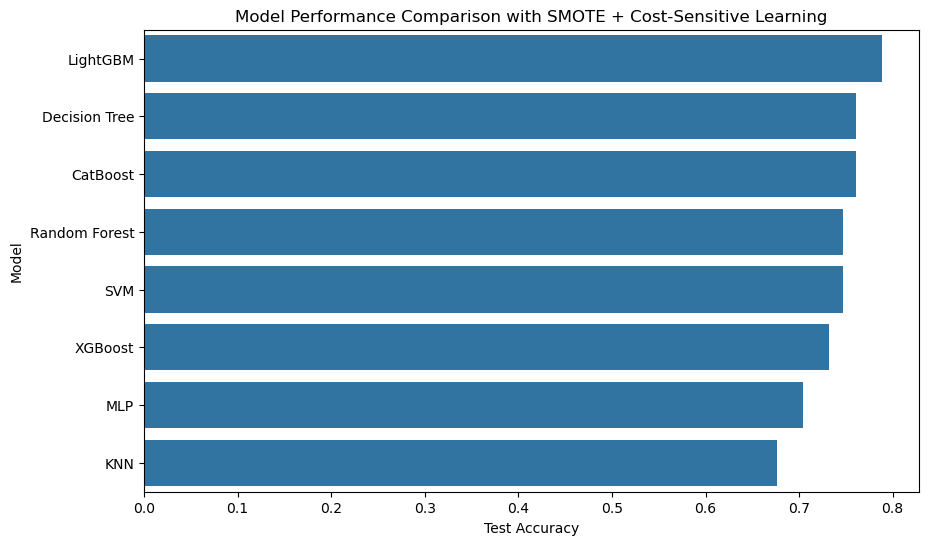

In [7]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.utils.class_weight import compute_class_weight
warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Compute class weights
class_weights = compute_class_weight(class_weight="balanced", classes=np.unique(y_resampled), y=y_resampled)
class_weight_dict = {i: class_weights[i] for i in range(len(class_weights))}

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models with cost-sensitive learning
models = {
    "Decision Tree": DecisionTreeClassifier(class_weight="balanced"),
    "Random Forest": RandomForestClassifier(class_weight="balanced"),
    "XGBoost": XGBClassifier(scale_pos_weight=class_weights[1] / class_weights[0], use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True, class_weight="balanced"),
    "LightGBM": lgb.LGBMClassifier(class_weight=class_weight_dict),
    "CatBoost": cb.CatBoostClassifier(auto_class_weights="Balanced", verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, class_weight="balanced", random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, scale_pos_weight=class_weights[1] / class_weights[0], use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, class_weight="balanced", random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, class_weight=class_weight_dict, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "LightGBM"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=50, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# **STACKING CLASSIFIER**
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression(class_weight="balanced")
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# **VOTING CLASSIFIER**
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Pretty print results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n")
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison with SMOTE + Cost-Sensitive Learning")
plt.show()


[I 2025-02-13 22:09:19,920] A new study created in memory with name: no-name-54817154-02f9-4d38-9f01-ed01e2603240
[I 2025-02-13 22:09:20,283] Trial 2 finished with value: 0.6150709219858157 and parameters: {'n_estimators': 124, 'max_depth': 5}. Best is trial 2 with value: 0.6150709219858157.
[I 2025-02-13 22:09:20,628] Trial 1 finished with value: 0.6484042553191489 and parameters: {'n_estimators': 286, 'max_depth': 6}. Best is trial 1 with value: 0.6484042553191489.
[I 2025-02-13 22:09:20,706] Trial 0 finished with value: 0.640159574468085 and parameters: {'n_estimators': 323, 'max_depth': 12}. Best is trial 1 with value: 0.6484042553191489.
[I 2025-02-13 22:09:20,901] Trial 12 finished with value: 0.635904255319149 and parameters: {'n_estimators': 134, 'max_depth': 8}. Best is trial 1 with value: 0.6484042553191489.
[I 2025-02-13 22:09:20,945] Trial 14 finished with value: 0.6067375886524824 and parameters: {'n_estimators': 266, 'max_depth': 3}. Best is trial 1 with value: 0.64840425

Best parameters for Random Forest: {'n_estimators': 496, 'max_depth': 7}


[I 2025-02-13 22:09:28,834] Trial 0 finished with value: 0.6319148936170211 and parameters: {'n_estimators': 433, 'max_depth': 13, 'learning_rate': 0.06657396520993637}. Best is trial 3 with value: 0.635904255319149.
[I 2025-02-13 22:09:28,879] Trial 4 finished with value: 0.6150709219858157 and parameters: {'n_estimators': 267, 'max_depth': 14, 'learning_rate': 0.1278043136121128}. Best is trial 3 with value: 0.635904255319149.
[I 2025-02-13 22:09:28,893] Trial 2 finished with value: 0.6318262411347517 and parameters: {'n_estimators': 167, 'max_depth': 11, 'learning_rate': 0.2333960634743413}. Best is trial 3 with value: 0.635904255319149.
[I 2025-02-13 22:09:28,967] Trial 5 finished with value: 0.640159574468085 and parameters: {'n_estimators': 209, 'max_depth': 5, 'learning_rate': 0.1888007247004357}. Best is trial 5 with value: 0.640159574468085.
[I 2025-02-13 22:09:29,031] Trial 6 finished with value: 0.6108156028368794 and parameters: {'n_estimators': 476, 'max_depth': 3, 'learni

Best parameters for XGBoost: {'n_estimators': 490, 'max_depth': 8, 'learning_rate': 0.200061275345375}


[I 2025-02-13 22:09:30,354] Trial 7 finished with value: 0.6359042553191491 and parameters: {'C': 9.666023422366887, 'kernel': 'rbf'}. Best is trial 4 with value: 0.6359042553191491.
[I 2025-02-13 22:09:30,355] Trial 10 finished with value: 0.5562943262411346 and parameters: {'C': 1.5969069859523817, 'kernel': 'linear'}. Best is trial 4 with value: 0.6359042553191491.
[I 2025-02-13 22:09:30,380] Trial 12 finished with value: 0.5562943262411346 and parameters: {'C': 3.2666035799834643, 'kernel': 'linear'}. Best is trial 4 with value: 0.6359042553191491.
[I 2025-02-13 22:09:30,425] Trial 9 finished with value: 0.6359042553191491 and parameters: {'C': 9.703912959093492, 'kernel': 'rbf'}. Best is trial 4 with value: 0.6359042553191491.
[I 2025-02-13 22:09:30,428] Trial 17 finished with value: 0.6316489361702128 and parameters: {'C': 8.680392231680152, 'kernel': 'rbf'}. Best is trial 4 with value: 0.6359042553191491.
[I 2025-02-13 22:09:30,428] Trial 2 finished with value: 0.556294326241134

Best parameters for SVM: {'C': 9.452148979866752, 'kernel': 'rbf'}


[I 2025-02-13 22:09:31,329] Trial 2 finished with value: 0.5814716312056738 and parameters: {'n_estimators': 191, 'learning_rate': 0.036844077963348744, 'num_leaves': 103}. Best is trial 2 with value: 0.5814716312056738.
[I 2025-02-13 22:09:31,787] Trial 1 finished with value: 0.6023936170212766 and parameters: {'n_estimators': 246, 'learning_rate': 0.28743270129069126, 'num_leaves': 146}. Best is trial 1 with value: 0.6023936170212766.
[I 2025-02-13 22:09:31,891] Trial 0 finished with value: 0.5940602836879434 and parameters: {'n_estimators': 473, 'learning_rate': 0.2156739720267737, 'num_leaves': 96}. Best is trial 1 with value: 0.6023936170212766.
[I 2025-02-13 22:09:32,230] Trial 3 finished with value: 0.5941489361702128 and parameters: {'n_estimators': 183, 'learning_rate': 0.2425156318534892, 'num_leaves': 87}. Best is trial 1 with value: 0.6023936170212766.
[I 2025-02-13 22:09:32,702] Trial 7 finished with value: 0.5731382978723405 and parameters: {'n_estimators': 319, 'learning

Best parameters for LightGBM: {'n_estimators': 246, 'learning_rate': 0.28743270129069126, 'num_leaves': 146}
[LightGBM] [Info] Number of positive: 141, number of negative: 98
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 179
[LightGBM] [Info] Number of data points in the train set: 239, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.589958 -> initscore=0.363792
[LightGBM] [Info] Start training from score 0.363792
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

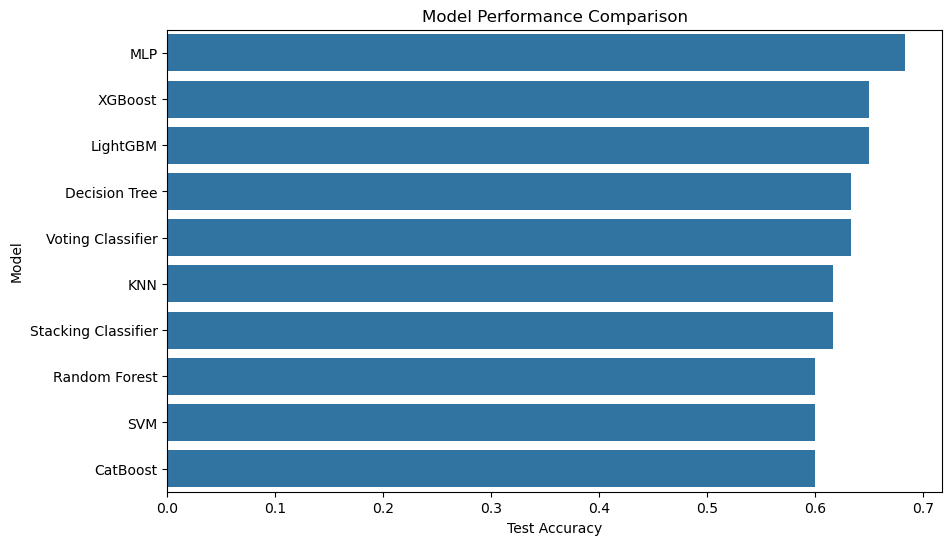

In [8]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import SMOTE, ADASYN
warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
# X_resampled, y_resampled = smote_enn.fit_resample(X, y)
X_resampled, y_resampled = X, y
# adasyn = ADASYN()
# X_resampled, y_resampled = adasyn.fit_resample(X, y)

# smote = SMOTE(random_state=42)
# X_resampled, y_resampled = smote.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "LightGBM"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=50, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# **STACKING CLASSIFIER**
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# **VOTING CLASSIFIER**
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Store stacking and voting results
for name, model in [("Stacking Classifier", stacking_model), ("Voting Classifier", voting_model)]:
    results.append({"Model": name, "Train Accuracy": accuracy_score(y_train, model.predict(X_train)), "Test Accuracy": accuracy_score(y_test, model.predict(X_test))})

# Pretty print results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n")
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()


[I 2025-02-13 22:24:33,340] A new study created in memory with name: no-name-ae105558-530e-4aa4-a3f7-b2d8b5f2cfe0
[I 2025-02-13 22:24:36,984] Trial 7 finished with value: 0.694047619047619 and parameters: {'n_estimators': 382, 'max_depth': 13}. Best is trial 7 with value: 0.694047619047619.
[I 2025-02-13 22:24:37,156] Trial 0 finished with value: 0.6904761904761905 and parameters: {'n_estimators': 476, 'max_depth': 8}. Best is trial 7 with value: 0.694047619047619.
[I 2025-02-13 22:24:37,291] Trial 4 finished with value: 0.6904761904761905 and parameters: {'n_estimators': 481, 'max_depth': 9}. Best is trial 7 with value: 0.694047619047619.
[I 2025-02-13 22:24:37,522] Trial 5 finished with value: 0.6869047619047619 and parameters: {'n_estimators': 200, 'max_depth': 14}. Best is trial 7 with value: 0.694047619047619.
[I 2025-02-13 22:24:37,712] Trial 1 finished with value: 0.694110275689223 and parameters: {'n_estimators': 411, 'max_depth': 6}. Best is trial 1 with value: 0.6941102756892

Best parameters for Random Forest: {'n_estimators': 460, 'max_depth': 11}


[I 2025-02-13 22:47:39,743] Trial 1 finished with value: 0.6478696741854637 and parameters: {'n_estimators': 428, 'max_depth': 15, 'learning_rate': 0.1260586283276563}. Best is trial 1 with value: 0.6478696741854637.
[I 2025-02-13 22:47:39,775] Trial 0 finished with value: 0.612280701754386 and parameters: {'n_estimators': 445, 'max_depth': 3, 'learning_rate': 0.19342534919700172}. Best is trial 1 with value: 0.6478696741854637.
[I 2025-02-13 22:47:39,812] Trial 4 finished with value: 0.6550125313283208 and parameters: {'n_estimators': 315, 'max_depth': 14, 'learning_rate': 0.24324173177882816}. Best is trial 4 with value: 0.6550125313283208.
[I 2025-02-13 22:47:39,835] Trial 2 finished with value: 0.6408521303258146 and parameters: {'n_estimators': 277, 'max_depth': 8, 'learning_rate': 0.17508428455059344}. Best is trial 4 with value: 0.6550125313283208.
[I 2025-02-13 22:47:39,887] Trial 5 finished with value: 0.6480576441102757 and parameters: {'n_estimators': 461, 'max_depth': 6, 'l

Best parameters for XGBoost: {'n_estimators': 315, 'max_depth': 7, 'learning_rate': 0.2558947551336597}


[I 2025-02-13 22:56:10,211] Trial 6 finished with value: 0.643859649122807 and parameters: {'C': 8.722984978269261, 'kernel': 'rbf'}. Best is trial 0 with value: 0.643859649122807.
[I 2025-02-13 22:56:10,251] Trial 10 finished with value: 0.6617794486215539 and parameters: {'C': 4.258378804276088, 'kernel': 'rbf'}. Best is trial 10 with value: 0.6617794486215539.
[I 2025-02-13 22:56:10,269] Trial 8 finished with value: 0.5765664160401003 and parameters: {'C': 6.084064981285769, 'kernel': 'linear'}. Best is trial 10 with value: 0.6617794486215539.
[I 2025-02-13 22:56:10,284] Trial 15 finished with value: 0.643859649122807 and parameters: {'C': 8.620665589189063, 'kernel': 'rbf'}. Best is trial 10 with value: 0.6617794486215539.
[I 2025-02-13 22:56:10,307] Trial 17 finished with value: 0.6689223057644111 and parameters: {'C': 2.7149139322586304, 'kernel': 'rbf'}. Best is trial 17 with value: 0.6689223057644111.
[I 2025-02-13 22:56:10,309] Trial 13 finished with value: 0.6617167919799499 

Best parameters for SVM: {'C': 2.7149139322586304, 'kernel': 'rbf'}


[I 2025-02-13 22:59:32,300] Trial 2 finished with value: 0.6621553884711779 and parameters: {'n_estimators': 109, 'learning_rate': 0.2954978479396827, 'num_leaves': 140}. Best is trial 2 with value: 0.6621553884711779.
[I 2025-02-13 22:59:32,588] Trial 1 finished with value: 0.6300125313283209 and parameters: {'n_estimators': 240, 'learning_rate': 0.09076540442912753, 'num_leaves': 123}. Best is trial 2 with value: 0.6621553884711779.
[I 2025-02-13 22:59:32,726] Trial 4 finished with value: 0.6265664160401002 and parameters: {'n_estimators': 203, 'learning_rate': 0.2008536232629211, 'num_leaves': 54}. Best is trial 2 with value: 0.6621553884711779.
[I 2025-02-13 22:59:32,918] Trial 0 finished with value: 0.6302005012531329 and parameters: {'n_estimators': 355, 'learning_rate': 0.25609154381712973, 'num_leaves': 141}. Best is trial 2 with value: 0.6621553884711779.
[I 2025-02-13 22:59:33,327] Trial 9 finished with value: 0.6586466165413534 and parameters: {'n_estimators': 285, 'learning

Best parameters for LightGBM: {'n_estimators': 446, 'learning_rate': 0.29472374643418153, 'num_leaves': 119}
[LightGBM] [Info] Number of positive: 141, number of negative: 140
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 198
[LightGBM] [Info] Number of data points in the train set: 281, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.501779 -> initscore=0.007117
[LightGBM] [Info] Start training from score 0.007117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further

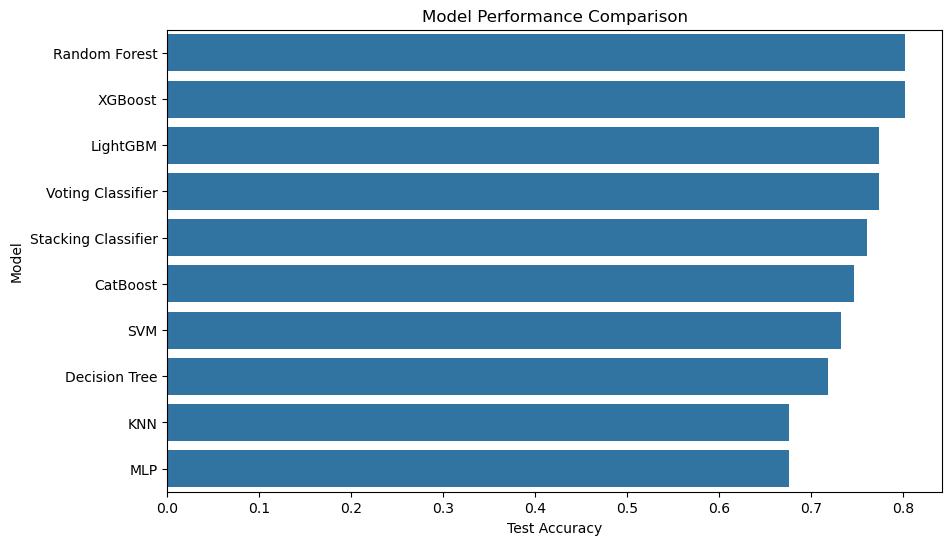

In [11]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import SMOTE, ADASYN
warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
# X_resampled, y_resampled = smote_enn.fit_resample(X, y)
X_resampled, y_resampled = X, y
# adasyn = ADASYN()
# X_resampled, y_resampled = adasyn.fit_resample(X, y)

smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "LightGBM"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=5000, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# **STACKING CLASSIFIER**
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# **VOTING CLASSIFIER**
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Store stacking and voting results
for name, model in [("Stacking Classifier", stacking_model), ("Voting Classifier", voting_model)]:
    results.append({"Model": name, "Train Accuracy": accuracy_score(y_train, model.predict(X_train)), "Test Accuracy": accuracy_score(y_test, model.predict(X_test))})

# Pretty print results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n")
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()


[I 2025-02-13 22:11:16,681] A new study created in memory with name: no-name-d8e0fe09-129a-42de-a3e5-e84ca7a275b3
[I 2025-02-13 22:11:16,980] Trial 2 finished with value: 0.6371043771043772 and parameters: {'n_estimators': 133, 'max_depth': 15}. Best is trial 2 with value: 0.6371043771043772.
[I 2025-02-13 22:11:17,251] Trial 7 finished with value: 0.6517845117845118 and parameters: {'n_estimators': 150, 'max_depth': 7}. Best is trial 7 with value: 0.6517845117845118.
[I 2025-02-13 22:11:17,763] Trial 15 finished with value: 0.659124579124579 and parameters: {'n_estimators': 293, 'max_depth': 10}. Best is trial 15 with value: 0.659124579124579.
[I 2025-02-13 22:11:17,938] Trial 12 finished with value: 0.6555555555555556 and parameters: {'n_estimators': 299, 'max_depth': 8}. Best is trial 15 with value: 0.659124579124579.
[I 2025-02-13 22:11:17,971] Trial 1 finished with value: 0.6663973063973063 and parameters: {'n_estimators': 413, 'max_depth': 9}. Best is trial 1 with value: 0.666397

Best parameters for Random Forest: {'n_estimators': 335, 'max_depth': 5}


[I 2025-02-13 22:11:26,565] Trial 2 finished with value: 0.6259259259259259 and parameters: {'n_estimators': 345, 'max_depth': 4, 'learning_rate': 0.08249006886090209}. Best is trial 2 with value: 0.6259259259259259.
[I 2025-02-13 22:11:26,598] Trial 5 finished with value: 0.5931986531986533 and parameters: {'n_estimators': 377, 'max_depth': 10, 'learning_rate': 0.16237043369230078}. Best is trial 2 with value: 0.6259259259259259.
[I 2025-02-13 22:11:26,624] Trial 3 finished with value: 0.6150841750841751 and parameters: {'n_estimators': 205, 'max_depth': 7, 'learning_rate': 0.20120170429831724}. Best is trial 2 with value: 0.6259259259259259.
[I 2025-02-13 22:11:26,793] Trial 4 finished with value: 0.6152188552188552 and parameters: {'n_estimators': 454, 'max_depth': 6, 'learning_rate': 0.12175684760629141}. Best is trial 2 with value: 0.6259259259259259.
[I 2025-02-13 22:11:26,812] Trial 13 finished with value: 0.6187205387205388 and parameters: {'n_estimators': 161, 'max_depth': 14,

Best parameters for XGBoost: {'n_estimators': 418, 'max_depth': 14, 'learning_rate': 0.015918635670975706}


[I 2025-02-13 22:11:28,676] Trial 3 finished with value: 0.6227609427609427 and parameters: {'C': 3.4057961272805892, 'kernel': 'linear'}. Best is trial 2 with value: 0.6556228956228957.
[I 2025-02-13 22:11:28,676] Trial 4 finished with value: 0.6483501683501682 and parameters: {'C': 4.322503791263323, 'kernel': 'rbf'}. Best is trial 2 with value: 0.6556228956228957.
[I 2025-02-13 22:11:28,677] Trial 5 finished with value: 0.6227609427609427 and parameters: {'C': 5.735425462688842, 'kernel': 'linear'}. Best is trial 2 with value: 0.6556228956228957.
[I 2025-02-13 22:11:28,677] Trial 15 finished with value: 0.6227609427609427 and parameters: {'C': 0.6839926124411745, 'kernel': 'linear'}. Best is trial 2 with value: 0.6556228956228957.
[I 2025-02-13 22:11:28,744] Trial 13 finished with value: 0.6261952861952862 and parameters: {'C': 2.2975348581746657, 'kernel': 'rbf'}. Best is trial 2 with value: 0.6556228956228957.
[I 2025-02-13 22:11:28,746] Trial 14 finished with value: 0.62983164983

Best parameters for SVM: {'C': 5.3262515866345845, 'kernel': 'rbf'}


[I 2025-02-13 22:11:30,508] Trial 0 finished with value: 0.5820875420875422 and parameters: {'n_estimators': 400, 'learning_rate': 0.2662792406938001, 'num_leaves': 40}. Best is trial 0 with value: 0.5820875420875422.
[I 2025-02-13 22:11:31,481] Trial 2 finished with value: 0.5965656565656566 and parameters: {'n_estimators': 238, 'learning_rate': 0.19654836034967324, 'num_leaves': 128}. Best is trial 2 with value: 0.5965656565656566.
[I 2025-02-13 22:11:31,574] Trial 3 finished with value: 0.6076767676767677 and parameters: {'n_estimators': 199, 'learning_rate': 0.06642546668634934, 'num_leaves': 96}. Best is trial 3 with value: 0.6076767676767677.
[I 2025-02-13 22:11:31,738] Trial 1 finished with value: 0.6115151515151515 and parameters: {'n_estimators': 480, 'learning_rate': 0.029941763599448584, 'num_leaves': 33}. Best is trial 1 with value: 0.6115151515151515.
[I 2025-02-13 22:11:31,793] Trial 4 finished with value: 0.6039730639730639 and parameters: {'n_estimators': 378, 'learning

Best parameters for LightGBM: {'n_estimators': 117, 'learning_rate': 0.1341336935879197, 'num_leaves': 91}
[LightGBM] [Info] Number of positive: 140, number of negative: 133
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 197
[LightGBM] [Info] Number of data points in the train set: 273, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512821 -> initscore=0.051293
[LightGBM] [Info] Start training from score 0.051293
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

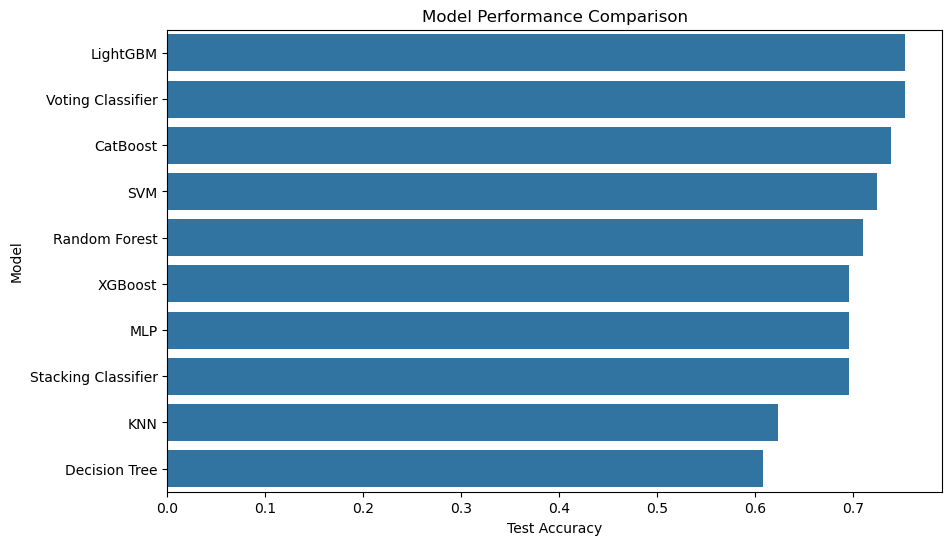

In [10]:
import pandas as pd
import numpy as np
import joblib
import optuna
import warnings
import lightgbm as lgb
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.combine import SMOTEENN
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, StackingClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import SMOTE, ADASYN
warnings.filterwarnings("ignore")

# Load dataset
file_path = "data.xlsx"
df = pd.read_excel(file_path, sheet_name="Form responses 1")

# Define features and target variable
selected_features = [
    'Age', 'Gender', 'Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition',
    'Fever', 'Nausea or vomiting', 'WBC count(cells/cumm)', 'Urine leucocytes', 'Fatigue',
    'Lower abdominal pain', 'Serum Creatinine (mg/dL)', 'Indwelling foley catheter',
    'Dysuria(painful urination)'
]
target_variable = 'Bacteria (present/absent)'

# Ensure feature columns exist
selected_features = [col for col in selected_features if col in df.columns]
df = df[selected_features + [target_variable]]

# Encode binary categorical features
binary_columns = ['Diabetes mellitus', 'Chronic kidney disease', 'Burning Micturition', 
                  'Fever', 'Nausea or vomiting', 'Fatigue', 'Lower abdominal pain', 
                  'Indwelling foley catheter', 'Dysuria(painful urination)', 'Bacteria (present/absent)']

for col in binary_columns:
    df[col] = df[col].str.strip().str.lower().map({'yes': 1, 'no': 0, 'present': 1, 'absent': 0})

# Encode gender (Male = 1, Female = 0)
df['Gender'] = df['Gender'].str.strip().str.lower().map({'male': 1, 'female': 0})

# Convert numeric columns to float
num_cols = ['WBC count(cells/cumm)', 'Urine leucocytes', 'Serum Creatinine (mg/dL)']
df[num_cols] = df[num_cols].apply(pd.to_numeric, errors='coerce')

# Fill missing values
df.fillna(df.median(), inplace=True)

# Define features (X) and target (y)
X = df.drop(columns=[target_variable])
y = df[target_variable]

# Handle imbalanced data using SMOTE-ENN
smote_enn = SMOTEENN()
# X_resampled, y_resampled = smote_enn.fit_resample(X, y)
X_resampled, y_resampled = X, y
adasyn = ADASYN()
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# smote = SMOTE(random_state=42)
# X_resampled, y_resampled = smote.fit_resample(X, y)

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_resampled)
joblib.dump(scaler, "scaler.joblib")

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled)

# Define base models
models = {
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss"),
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0),
    "MLP": MLPClassifier(max_iter=500)
}

# Hyperparameter tuning function
def optimize_model(trial, model_name):
    params = {}

    if model_name == "Random Forest":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15)
        }
        model = RandomForestClassifier(**params, random_state=42)

    elif model_name == "XGBoost":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "max_depth": trial.suggest_int("max_depth", 3, 15),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3)
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss", random_state=42)

    elif model_name == "SVM":
        params = {
            "C": trial.suggest_float("C", 0.1, 10.0),
            "kernel": trial.suggest_categorical("kernel", ["linear", "rbf"])
        }
        model = SVC(**params, probability=True, random_state=42)

    elif model_name == "LightGBM":
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 100, 500),
            "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
            "num_leaves": trial.suggest_int("num_leaves", 20, 150)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)

    score = cross_val_score(model, X_train, y_train, cv=5, scoring="accuracy", n_jobs=-1).mean()
    return score

# Tune selected models
tuned_models = ["Random Forest", "XGBoost", "SVM", "LightGBM"]
best_params = {}

for model_name in tuned_models:
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: optimize_model(trial, model_name), n_trials=50, n_jobs=-1)
    best_params[model_name] = study.best_params
    print(f"Best parameters for {model_name}: {study.best_params}")

# Train models with best params
trained_models = {}
results = []

for name, model in models.items():
    if name in best_params:
        model.set_params(**best_params[name])

    model.fit(X_train, y_train)
    trained_models[name] = model
    joblib.dump(model, f"{name}.joblib")

    train_acc = accuracy_score(y_train, model.predict(X_train))
    test_acc = accuracy_score(y_test, model.predict(X_test))
    
    results.append({"Model": name, "Train Accuracy": train_acc, "Test Accuracy": test_acc})

# **STACKING CLASSIFIER**
stacking_model = StackingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    final_estimator=LogisticRegression()
)
stacking_model.fit(X_train, y_train)
joblib.dump(stacking_model, "StackingClassifier.joblib")

# **VOTING CLASSIFIER**
voting_model = VotingClassifier(
    estimators=[("RF", trained_models["Random Forest"]), ("XGB", trained_models["XGBoost"]), ("LGBM", trained_models["LightGBM"])],
    voting="soft"
)
voting_model.fit(X_train, y_train)
joblib.dump(voting_model, "VotingClassifier.joblib")

# Store stacking and voting results
for name, model in [("Stacking Classifier", stacking_model), ("Voting Classifier", voting_model)]:
    results.append({"Model": name, "Train Accuracy": accuracy_score(y_train, model.predict(X_train)), "Test Accuracy": accuracy_score(y_test, model.predict(X_test))})

# Pretty print results
results_df = pd.DataFrame(results).sort_values(by="Test Accuracy", ascending=False)
print("\nFinal Model Performance:\n")
print(results_df)

# Plot results
plt.figure(figsize=(10, 6))
sns.barplot(x="Test Accuracy", y="Model", data=results_df)
plt.title("Model Performance Comparison")
plt.show()
